In [ ]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="0"

In [ ]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

In [ ]:
colordict = {'YY1 +': '#1F77B4',
    'YY1 -': '#c2d5e8',
    'TATA +': '#E41A1C',
    'TATA -': '#ffc6ba',
    '5\' splice site +': '#9F9F9F',
    '5\' splice site -': '#CFCFCF',
    'NFY +': '#00CC96',
    'NFY -': '#00cc5f',
    'ETS +': '#19d3f3',
    'ETS -': '#19e4f3',
    'SP +': '#FF7F0E',
    'SP -': '#ff930e',
    'NRF1 +': '#AB63FA',
    'NRF1 -': '#b663fa',
    'ZNF143 +': '#17a4cf',
    'ZNF133 -': '#17BECF',
    'CREB +': '#FF6692',
    'CREB -': '#ff66c2',
    'Long Inr +': '#95a2be',
    'Long Inr -': '#dde1ea'}

In [ ]:
import pandas as pd
import selene_sdk

tsses  = pd.read_table('./resources/FANTOM_CAT.lv3_robust.tss.sortedby_fantomcage.hg38.v5.tsv', sep='\t')
tsses_hc  = pd.read_table('./resources/FANTOM_CAT.lv3_robust.tss.sortedby_fantomcage.hg38.v5.highconf.tsv', sep='\t')
import sys
sys.path.append('./utils/')
from selene_utils2 import *
genome = MemmapGenome(
    input_path='./resources/Homo_sapiens.GRCh38.dna.primary_assembly.fa',
    memmapfile='./resources/Homo_sapiens.GRCh38.dna.primary_assembly.fa.mmap',
    blacklist_regions= 'hg38'
)

In [ ]:
import numpy as np
tss_preds = np.load('./data/tss_preds.npy')

In [ ]:
import torch
from torch import nn
from torch.autograd import grad

from torch_fftconv import fft_conv1d, FFTConv1d
import numpy as np
from copy import deepcopy

class simpleNet(nn.Module):
    def __init__(self):

        super(simpleNet, self).__init__()
        self.conv = nn.Conv1d(4,  10, kernel_size=51, padding=25)
        self.conv_inr = nn.Conv1d(4,  10, kernel_size=15, padding=7)
        self.conv_sim = nn.Conv1d(4,  32, kernel_size=3, padding=1)

        self.activation = nn.Softplus()
        self.softplus = nn.Softplus()

        self.deconv = FFTConv1d(10*2,  10, kernel_size=601, padding=300)
        self.deconv_sim = FFTConv1d(64,  10, kernel_size=601, padding=300)
        self.deconv_inr = nn.ConvTranspose1d(20,  10, kernel_size=15, padding=7)

        self.scaler = nn.Parameter(torch.ones(1))
        self.scaler2 = nn.Parameter(torch.ones(1))

    def forward(self, x):
        y = torch.cat([self.conv(x), self.conv(x.flip([1,2])).flip([2])], 1)
        y_sim = torch.cat([self.conv_sim(x), self.conv_sim(x.flip([1,2])).flip([2])], 1)
        y_inr = torch.cat([self.conv_inr(x), self.conv_inr(x.flip([1,2])).flip([2])], 1)

        yact = self.activation(y )
        y_sim_act = self.activation(y_sim)
        y_inr_act = self.activation(y_inr)

        y_pred = self.softplus(self.deconv(yact)+self.deconv_inr(y_inr_act)+self.deconv_sim(y_sim_act))
        return y_pred

net = simpleNet()
net.load_state_dict(torch.load('./resources/puffin.pth'))
net.cuda()


motifnames_original=  ['SP -', 'ETS -', 'CREB -', 'NFY -', 'YY1 -', 'U1 snRNP +', 'Long Inr +', 'NRF1 +', 'ZNF143 -', 'TATA -',
                      'SP +', 'ETS +', 'CREB +', 'NFY +', 'YY1 +', 'U1 snRNP -', 'Long Inr -', 'NRF1 -', 'ZNF143 +', 'TATA +']

motifnames_original  = np.array(motifnames_original)


In [ ]:
motifact = []
motifcontri = []


longinr_ind = motifnames_original.tolist().index('Long Inr +')
longinrrev_ind = motifnames_original.tolist().index('Long Inr -')
for tssi in range(40000):
    offset = 1 if tsses['strand'][tssi] == '-' else 0

    seq = genome.get_encoding_from_coords(tsses['chr'][tssi], tsses['TSS'][tssi]-825+offset, tsses['TSS'][tssi]+825+offset, tsses['strand'][tssi]).copy()

    preact_motif = torch.cat([net.conv(torch.FloatTensor(seq)[None,:,:].transpose(1,2).cuda()), \
                       net.conv(torch.FloatTensor(seq)[None,:,:].transpose(1,2).flip([1,2]).cuda()).flip([2])], 1)

    postact_motif = net.activation(preact_motif)
    postact_motif = postact_motif  
    motifact.append(postact_motif.cpu().detach().numpy())


    effects_motifs_all = []
    for targeti in range(10):
        effects_motifs = []    
        for i in range(20):
            effects_motif = np.convolve(postact_motif[0,i,:].detach().cpu().numpy(), net.deconv.weight.cpu().detach().numpy()[targeti,i,::-1], mode='same')[325:-325]
            effects_motifs.append(effects_motif)

        effects_motifs_all.append(effects_motifs)
        

    pred = net(torch.FloatTensor(seq)[None,:,:].transpose(1,2).cuda())


    effects_motifs_all = np.array(effects_motifs_all)
    motifcontri.append(effects_motifs_all[...,500-50:500+50])


motifact = np.concatenate(motifact)[:,:,325:-325]
motifcontri = np.array(motifcontri)
motifcontrimax = np.array(motifcontrimax)


#weighted sum motif contribution for the center +/- 10bp, weighted by tss_preds
motifcontri_weighted = ((tss_preds[:40000,:,None,500-10:500+10]) * motifcontri[:,:,:,50-10:50+10]).sum(axis=3) / (tss_preds[:40000,:,None,500-10:500+10]).sum(axis=3)


In [ ]:
motifcontri = np.load('./data/motifcontri.npy')
motifcontri_weighted2 = ((tss_preds[:40000,:,None,500-20:500+20]) * motifcontri[:,:,:,50-20:50+20]).sum(axis=3) / (tss_preds[:40000,:,None,500-20:500+20]).sum(axis=3)


In [ ]:
inds_noinr = np.setdiff1d(np.arange(20), [motifnames_original.tolist().index('Long Inr +'),
                                         motifnames_original.tolist().index('Long Inr -')] )
inds_noinrnoss = np.setdiff1d(np.arange(20), [motifnames_original.tolist().index('Long Inr +'),
                                         motifnames_original.tolist().index('Long Inr -'),
                                             motifnames_original.tolist().index('U1 snRNP +'),
                                         motifnames_original.tolist().index('U1 snRNP -')] )

In [ ]:
np.save(arr=motifact, file='./data/motifact.npy')
np.save(arr=motifcontri, file='./data/motifcontri.npy')
np.save(arr=motifcontrimax, file='./data/motifcontrimax.npy')
np.save(arr=motifcontri_weighted, file='./data/motifcontri_weighted.npy')

In [ ]:
import numpy as np
motifcontri_weighted = np.load('./data/motifcontri_weighted.npy')

In [ ]:
motifeffects = np.load('./data/motif_effects.npy')

In [ ]:
longinr_baseline = motifeffects[:,6,:,:].mean(0).min(-1)
longinrrev_baseline = motifeffects[:,-4,:,:].mean(0).min(-1)

In [ ]:
motifcontri_weighted[:,:5,6] =  motifcontri_weighted[:,:5,6]-longinr_baseline[None,:]
motifcontri_weighted[:,:5,-4] =  motifcontri_weighted[:,:5,-4]-longinrrev_baseline[None,:]

In [ ]:
import pandas as pd
motifcontri_fulldf = pd.DataFrame(motifcontri_weighted[:40000,0,:], index=tsses['geneName'].values[:40000], \
                                    columns=motifnames_original)
motifcontri_fulldf.index = tsses['geneName'].values[:40000]
motifcontri_fulldf = motifcontri_fulldf.loc[:,['TATA +', 'YY1 +', 'SP +','SP -','ETS +','ETS -', \
                                       'NFY +', 'NFY -', 'CREB +','CREB -', \
                                      'NRF1 +', 'NRF1 -','ZNF143 +','ZNF143 -', 'U1 snRNP +', \
                                        'U1 snRNP -', 'Long Inr +', 'Long Inr -']]
motifcontri_fulldf.to_csv('./data/motifcontri_fulldf.tsv', sep='\t')

In [ ]:
import pandas as pd
motifcontri_fulldf = pd.DataFrame(motifcontri_weighted[:40000,4,:], index=tsses['geneName'].values[:40000], \
                                    columns=motifnames_original)
motifcontri_fulldf.index = tsses['geneName'].values[:40000]
motifcontri_fulldf = motifcontri_fulldf.loc[:,['TATA +', 'YY1 +', 'SP +','SP -','ETS +','ETS -', \
                                       'NFY +', 'NFY -', 'CREB +','CREB -', \
                                      'NRF1 +', 'NRF1 -','ZNF143 +','ZNF143 -', 'U1 snRNP +', \
                                        'U1 snRNP -', 'Long Inr +', 'Long Inr -']]
motifcontri_fulldf.to_csv('./data/motifcontri_fulldf.procap.tsv', sep='\t')

In [ ]:
motifcontri_df = pd.DataFrame(motifcontri_weighted[:40000,0,inds_noinrnoss], index=tsses['geneName'].values[:40000], \
                                    columns=motifnames_original[inds_noinrnoss])
motifcontri_df.index = tsses['geneName'].values[:40000]
motifcontri_df = motifcontri_df.loc[:,['TATA +', 'YY1 +', 'SP +','SP -','ETS +','ETS -', \
                                       'NFY +', 'NFY -', 'CREB +','CREB -', \
                                      'NRF1 +', 'NRF1 -','ZNF143 +','ZNF143 -']]

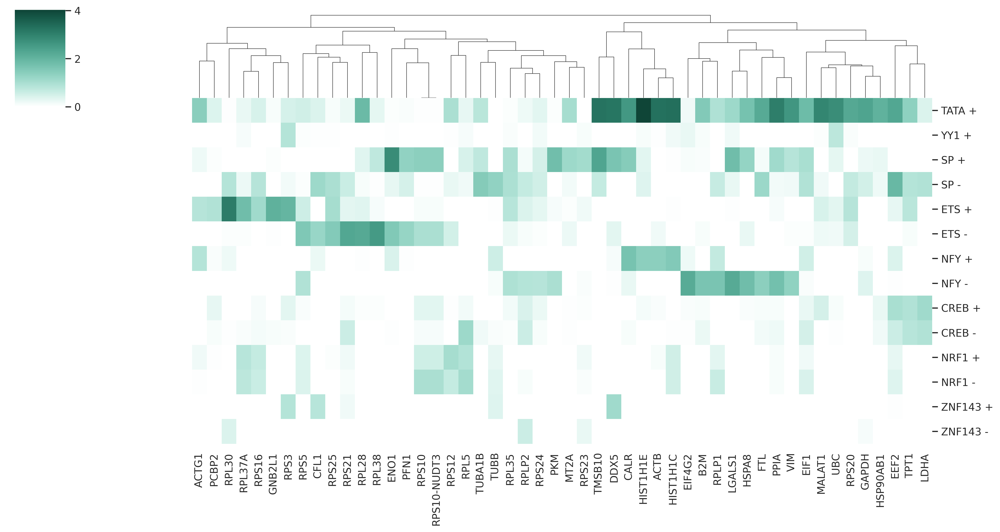

In [ ]:
import seaborn
seaborn.set(rc={"figure.dpi":300, 'savefig.dpi':300})
motifcontri_df = pd.DataFrame(motifcontri_weighted[:,0,inds_noinrnoss][np.setdiff1d(np.arange(52),[32,33])], index=tsses['geneName'].values[np.setdiff1d(np.arange(52),[32,33])], \
                                    columns=motifnames_original[inds_noinrnoss])
motifcontri_df.index = tsses['geneName'].values[np.setdiff1d(np.arange(52),[32,33])]
motifcontri_df = motifcontri_df.loc[:,['TATA +', 'YY1 +', 'SP +','SP -','ETS +','ETS -', \
                                       'NFY +', 'NFY -', 'CREB +','CREB -', \
                                      'NRF1 +', 'NRF1 -','ZNF143 +','ZNF143 -']]
        
    
c = seaborn.clustermap(motifcontri_df.T,
                   figsize=(15,8),cmap=seaborn.cubehelix_palette(start=2.3, rot=0., hue=1, dark=0.2, light=1,n_colors=255),vmin=0,row_cluster=False)
plt.savefig('./figures/motifcontri_top50.pdf', backend='cairo')


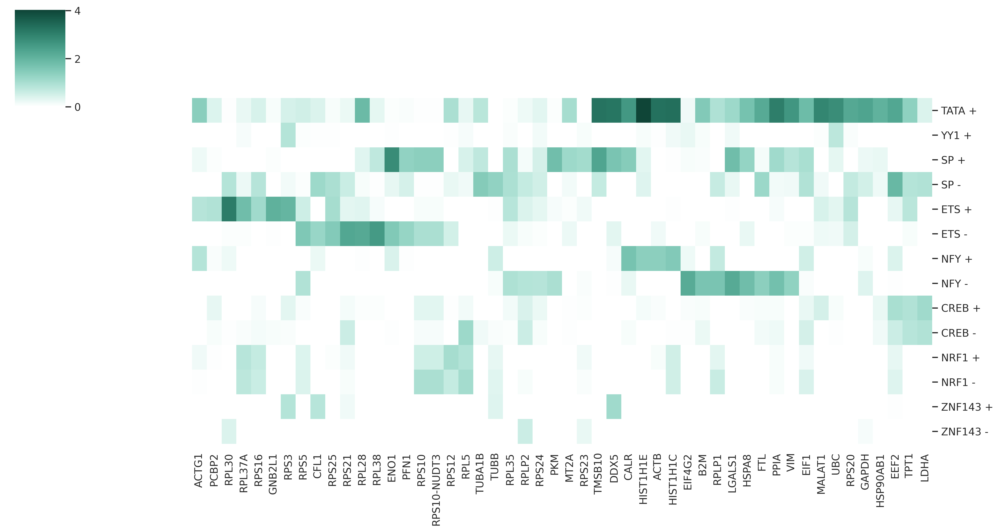

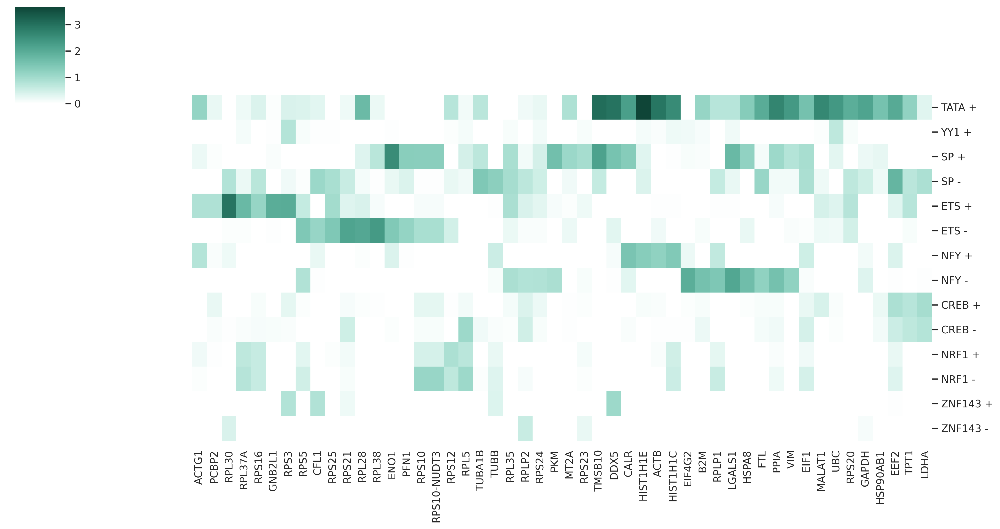

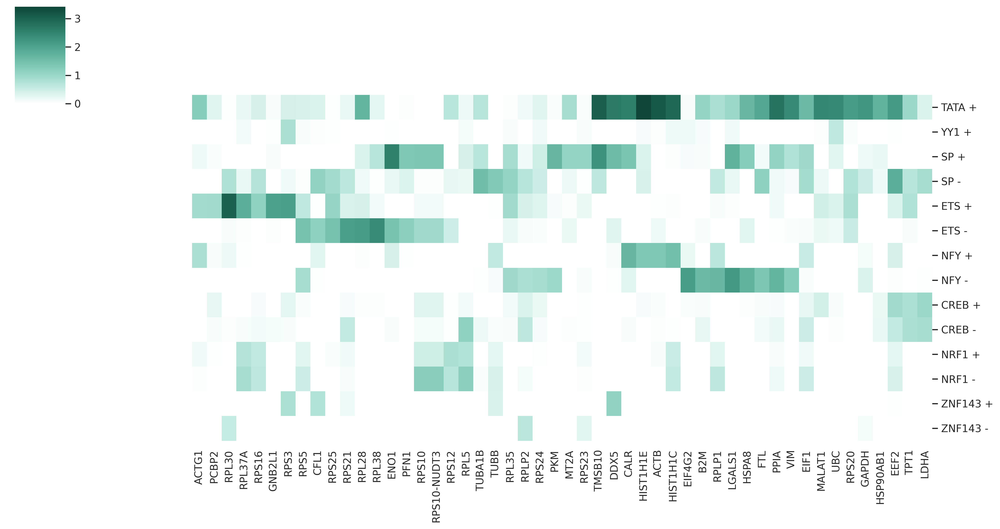

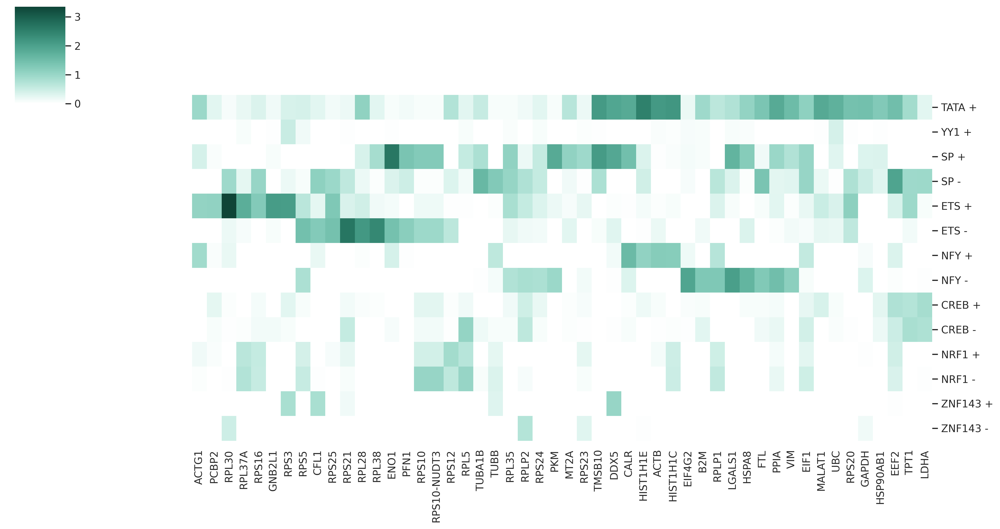

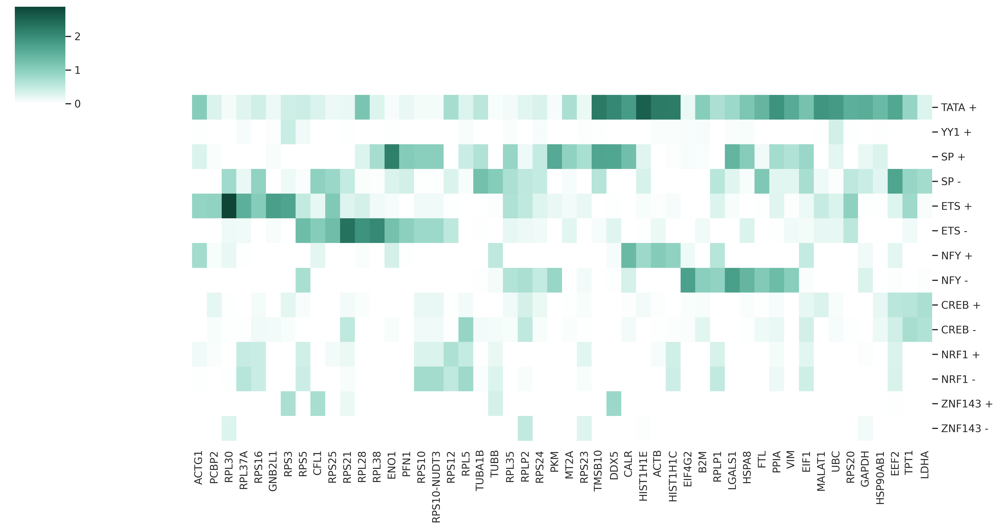

In [ ]:
from matplotlib import pyplot as plt
for i in range(5):
    motifcontri_df = pd.DataFrame(motifcontri_weighted[:,i,inds_noinrnoss][np.setdiff1d(np.arange(52),[32,33])], index=tsses['geneName'].values[np.setdiff1d(np.arange(52),[32,33])], \
                                        columns=motifnames_original[inds_noinrnoss])
    motifcontri_df.index = tsses['geneName'].values[np.setdiff1d(np.arange(52),[32,33])]
    motifcontri_df = motifcontri_df.loc[:,['TATA +', 'YY1 +', 'SP +','SP -','ETS +','ETS -', \
                                           'NFY +', 'NFY -', 'CREB +','CREB -', \
                                          'NRF1 +', 'NRF1 -','ZNF143 +','ZNF143 -']]
    seaborn.clustermap(motifcontri_df.T.iloc[:,c.dendrogram_col.reordered_ind],
                   figsize=(15,8),cmap=seaborn.cubehelix_palette(start=2.3, rot=0., hue=1, dark=0.2, light=1,n_colors=255),vmin=0,col_cluster=False,row_cluster=False)

    plt.savefig('./figures/motifcontri_top50.'+str(i)+'.pdf', backend='cairo')


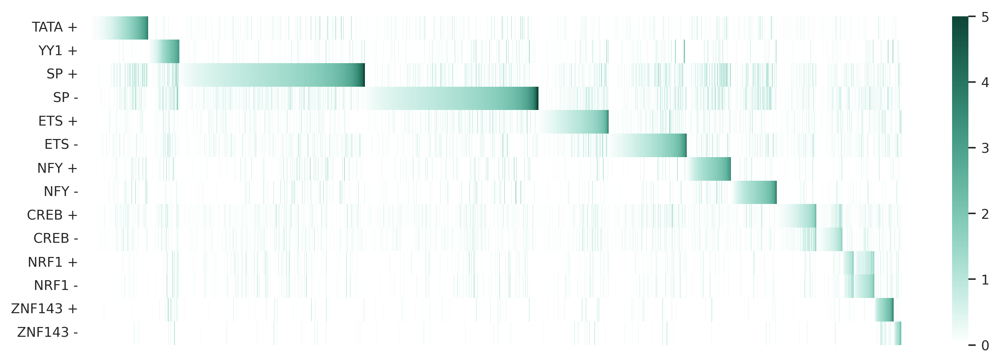

In [ ]:
from sklearn.decomposition import PCA
motifcontri_df = pd.DataFrame(motifcontri_weighted[:40000,0,inds_noinrnoss], index=tsses['geneName'].values[:40000], \
                                    columns=motifnames_original[inds_noinrnoss])
motifcontri_df.index = tsses['geneName'].values[:40000]
motifcontri_df = motifcontri_df.loc[:,['TATA +', 'YY1 +', 'SP +','SP -','ETS +','ETS -', \
                                       'NFY +', 'NFY -', 'CREB +','CREB -', \
                                      'NRF1 +', 'NRF1 -','ZNF143 +', 'ZNF143 -']]
        
motifcontri_argmax = motifcontri_df.values[:40000,:].argmax(axis=1)
perargmax_score = np.zeros(40000)
for i in range(motifcontri_df.shape[1]):
    perargmax_score[motifcontri_argmax==i] =  motifcontri_df.values[:40000,:][motifcontri_argmax==i][:,i]
    
import seaborn

plt.figure(figsize=(12,4),dpi=300)
seaborn.set_context("paper", font_scale = 1)

c = seaborn.heatmap(motifcontri_df.iloc[np.lexsort([perargmax_score, motifcontri_argmax]),:].T,
                       cmap=seaborn.cubehelix_palette(start=2.3, rot=0., hue=1, dark=0.2, light=1,n_colors=255),\
                    vmax=5,vmin=0, xticklabels=False, rasterized=True)
plt.savefig('./figures/motifcontri_top40000.pdf')


In [ ]:
motifactcontris = []
for tssi  in range(40000):
    offset = 1 if tsses['strand'][tssi] == '-' else 0
    seq = genome.get_encoding_from_coords(tsses['chr'][tssi], tsses['TSS'][tssi]-825+offset, tsses['TSS'][tssi]+825+offset, tsses['strand'][tssi]).copy()
    #target = tfeature.get_feature_data(tsses['chr'][tssi], tsses['TSS'][tssi]-800+offset, tsses['TSS'][tssi]+800+offset)
    #if tsses['strand'][tssi] == '-':
    #    target=target[::-1,::-1]
    seqt = torch.FloatTensor(seq)[None,:,:].transpose(1,2).cuda()
    
    preact_motif = torch.cat([net.conv(seqt), \
                       net.conv(seqt.flip([1,2])).flip([2])], 1)
    preact_inr = torch.cat([net.conv_inr(seqt), \
                       net.conv_inr(seqt.flip([1,2])).flip([2])], 1)
    preact_sim = torch.cat([net.conv_sim(seqt), \
                       net.conv_sim(seqt.flip([1,2])).flip([2])], 1)
    postact_motif = net.activation(preact_motif)
    postact_inr = net.activation(preact_inr)
    postact_sim = net.activation(preact_sim)

    motifactcontri = []
    for targeti in range(5):
        net.zero_grad()
        postact_motif_detached = postact_motif.detach()
        postact_motif_detached.requires_grad = True
        postact_inr_detached = postact_inr.detach()
        postact_inr_detached.requires_grad = True
        postact_sim_detached = postact_sim.detach()
        postact_sim_detached.requires_grad = True
        
        
        pred = net.activation(net.deconv(postact_motif_detached)+net.deconv_inr(postact_inr_detached)+net.deconv_sim(postact_sim_detached))
        predexp = 10**(pred[:,targeti, 825-10:825+10]/np.log(10))-1
        (predexp).sum().backward(retain_graph=True)
        
        
        motifactcontri.append((postact_motif_detached.grad * postact_motif_detached.data).cpu().numpy()[0,:,825-300:825+300])
    motifactcontris.append(motifactcontri)
motifactcontris = np.array(motifactcontris)
np.save(arr=motifactcontris, file='./data/motifactcontris.npy')

In [ ]:
import numpy as np
motifactcontris = np.load('./data/motifactcontris.npy')

In [ ]:
motifnames_original=  ['SP -', 'ETS -', 'CREB -', 'NFY -', 'YY1 -', 'U1 snRNP +', 'Long Inr +', 'NRF1 +', 'ZNF143 -', 'TATA -',
                      'SP +', 'ETS +', 'CREB +', 'NFY +', 'YY1 +', 'U1 snRNP -', 'Long Inr -', 'NRF1 -', 'ZNF143 +', 'TATA +']
inds_longinrs = np.where(np.array(['Long Inr' in m for m in motifnames_original]))[0]
inds_nolonginrs = np.setdiff1d(np.arange(20), inds_longinrs)


In [ ]:
p  = np.fmax(motifactcontris[:,0,inds_nolonginrs,:].sum(-2),0)
p  = p / p.sum(-1, keepdims=True)
p[p<0.02]= 0 
p  = p / p.sum(-1, keepdims=True)
eff_N = 2**( - np.nansum(p * np.log2(p), -1))

/home2/s190483/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
/home2/s190483/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in log2
  """
/home2/s190483/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in multiply
  """


In [ ]:
import pandas as pd
motifcontri_df = pd.DataFrame(motifcontri_weighted[:,0,:], columns = np.array(motifnames_original))
motifcontri_df['NFY +/-'] = motifcontri_df['NFY +'] + motifcontri_df['NFY -']
motifcontri_df['ETS +/-'] = motifcontri_df['ETS +'] + motifcontri_df['ETS -']
motifcontri_df['ZNF143 +/-'] = motifcontri_df['ZNF143 +'] + motifcontri_df['ZNF143 -']
motifcontri_df['CREB +/-'] = motifcontri_df['CREB +'] + motifcontri_df['CREB -']
motifcontri_df['SP +/-'] = motifcontri_df['SP +'] + motifcontri_df['SP -']
motifcontri_df['NRF1 +/-'] = motifcontri_df['NRF1 +'] + motifcontri_df['NRF1 -']
motifcontri_df = motifcontri_df.iloc[:, ~np.isin(motifcontri_df.columns, ['Long Inr +','Long Inr -', 'U1 snRNP +', 'U1 snRNP -', 'TATA -','YY1 -','NFY +','NFY -','NRF1 +','NRF1 -','ETS +','ETS -','SP +','SP -','ZNF143 +','ZNF143 -','CREB +','CREB -'])]
motifcontri_df.index = tsses['geneName'].values[:40000]


/home2/s190483/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home2/s190483/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  import sys
/home2/s190483/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarnin

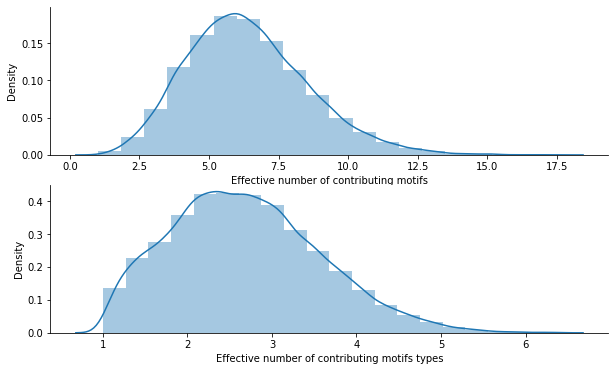

In [ ]:
from matplotlib import pyplot as plt
_, axes = plt.subplots(nrows=2, figsize=(10,6))

seaborn.distplot(eff_N,20, ax=axes[0])
axes[0].set_xlabel('Effective number of contributing motifs')

p=(np.fmax(motifcontri_df.iloc[:40000,:],0) / np.fmax(motifcontri_df.iloc[:40000,:],0).sum(axis=1)[:,None])
seaborn.distplot(2**(-np.log2(p) * p).sum(axis=1),20, ax=axes[1])
axes[1].set_xlabel('Effective number of contributing motifs types')

seaborn.despine()
plt.savefig("./figures/motifcontri_effective_N_motifs.pdf") 


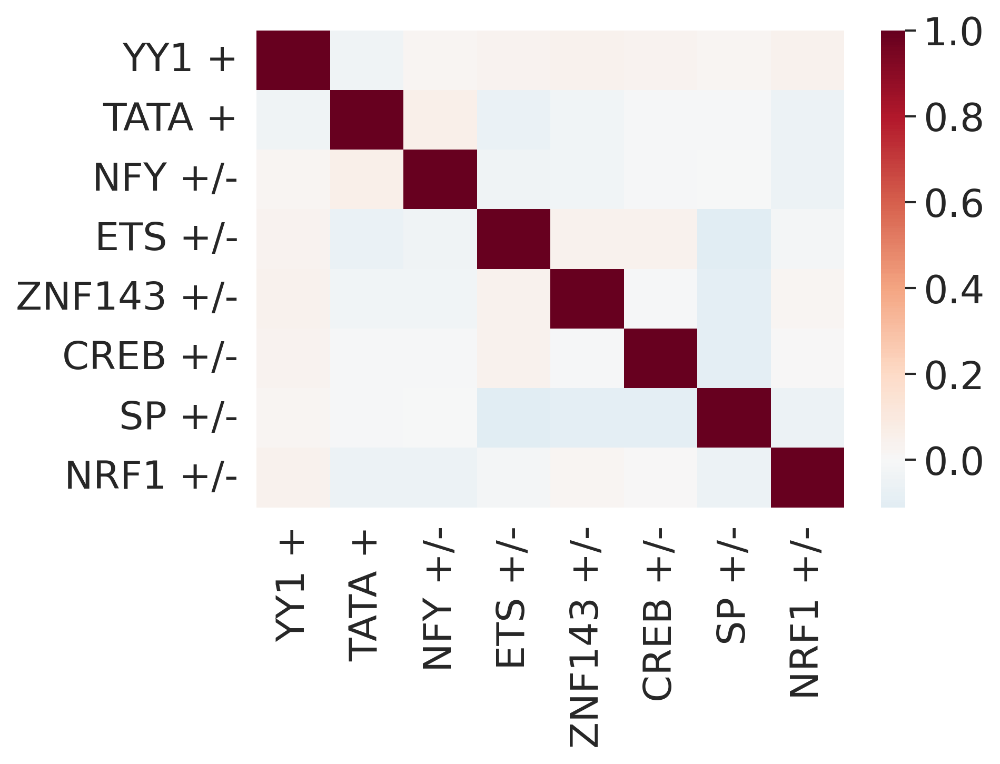

In [ ]:
seaborn.heatmap(pd.DataFrame(np.corrcoef(motifcontri_df.T), index = motifcontri_df.columns, 
                             columns = motifcontri_df.columns), cmap='RdBu_r', center=0)
plt.savefig("./figures/motifcontri.cormat.pdf")


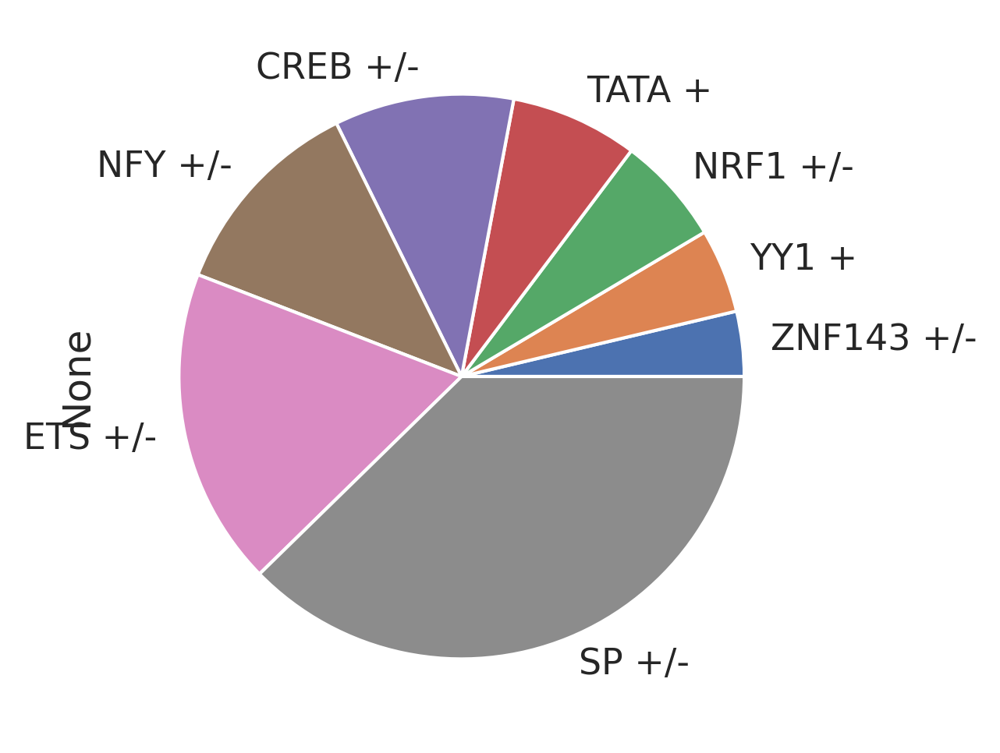

In [ ]:
seaborn.set(rc={"figure.dpi":300, 'savefig.dpi':300})
motifcontri_df.sum(axis=0).sort_values().plot.pie()
plt.savefig("./figures/motifcontri.pie.pdf") 


In [ ]:
tssdata_collapsed_fw = np.load('./resources/fantom_tssdata_collapsed_fw.npy')
fantom_tissue_filenames = np.load('./resources/fantom_tissue_filenames.npy')

In [ ]:
%load_ext rpy2.ipython

In [ ]:
%%R -i tssdata_collapsed_fw
require(DESeq2)

dds <- DESeqDataSetFromMatrix(countData = round(tssdata_collapsed_fw), 
                              colData=data.frame(placeholder=rep(0,length(tssdata_collapsed_fw[1,]))),
                              design= ~1)

dds <- estimateSizeFactors(dds)
dds <- estimateDispersions(dds)

vsd <- vst(dds, blind=TRUE)

R[write to console]: Loading required package: DESeq2

R[write to console]: Loading required package: S4Vectors

R[write to console]: Loading required package: stats4

R[write to console]: Loading required package: BiocGenerics

R[write to console]: Loading required package: parallel

R[write to console]: 
Attaching package: ‘BiocGenerics’


R[write to console]: The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


R[write to console]: The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


R[write to console]: The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, basename, cbind, colnames,
    dirname, do.call, duplicated, eval, evalq, Filter, Find, get, grep,
    grepl, intersect, is.unsorted, lapply, Map, mapply, match, mget,
    o

In [ ]:
%%R -o tssdata_collapsed_fw_vsd,sizefactor
sizefactor = sizeFactors(dds)
tssdata_collapsed_fw_vsd = assay(vsd)

In [ ]:
tssdata_collapsed_fw_norm =  tssdata_collapsed_fw / sizefactor[None,:]


In [ ]:
fantom_tissue_filenames_short = [( s.replace('sum.','').replace('.plus','').replace('_',' ')) for s in fantom_tissue_filenames]


In [ ]:
tssdata_collapsed_fw_norm = np.load('./data/tssdata_collapsed_fw_norm.npy')
tssdata_collapsed_filter = tsses['chr'][:40000].values!='chrY'
fantom_tissue_filenames_short = np.load('./data/fantom_tissue_filenames_short.npy')

In [ ]:
motifcontri_df = pd.DataFrame(motifcontri_weighted[:,0,:], columns = np.array(motifnames_original))
motifcontri_df['NFY +/-'] = motifcontri_df['NFY +'] + motifcontri_df['NFY -']
motifcontri_df['ETS +/-'] = motifcontri_df['ETS +'] + motifcontri_df['ETS -']
motifcontri_df['ZNF143 +/-'] = motifcontri_df['ZNF143 +'] + motifcontri_df['ZNF143 -']
motifcontri_df['CREB +/-'] = motifcontri_df['CREB +'] + motifcontri_df['CREB -']
motifcontri_df['SP +/-'] = motifcontri_df['SP +'] + motifcontri_df['SP -']
motifcontri_df['NRF1 +/-'] = motifcontri_df['NRF1 +'] + motifcontri_df['NRF1 -']
motifcontri_df = motifcontri_df.iloc[:, ~np.isin(motifcontri_df.columns, ['Long Inr +','Long Inr -', 'U1 snRNP +', 'U1 snRNP -', 'TATA -','YY1 -','NFY +','NFY -','NRF1 +','NRF1 -','ETS +','ETS -','SP +','SP -','ZNF143 +','ZNF143 -','CREB +','CREB -'])]
motifcontri_df.index = tsses['geneName'].values[:40000]


In [ ]:
from scipy.stats import pearsonr, spearmanr
x = motifcontri_df.iloc[tssdata_collapsed_filter,:].values
y = np.log(1+tssdata_collapsed_fw_norm.T)-np.log(1+tssdata_collapsed_fw_norm.T).mean(axis=0,keepdims=True)

plotdata = []
for i in range(x.shape[1]):
    cors = []
    for j in range(y.shape[0]):
        cors.append(pearsonr(x[:,i][x[:,i]>0.5], y[j,:][x[:,i]>0.5])[0])
    plotdata.append(cors)

In [ ]:
from sklearn.decomposition import PCA
tssdata_collapsed_fw_norm_pca = PCA(20).fit_transform(np.log(1+tssdata_collapsed_fw_norm.T))

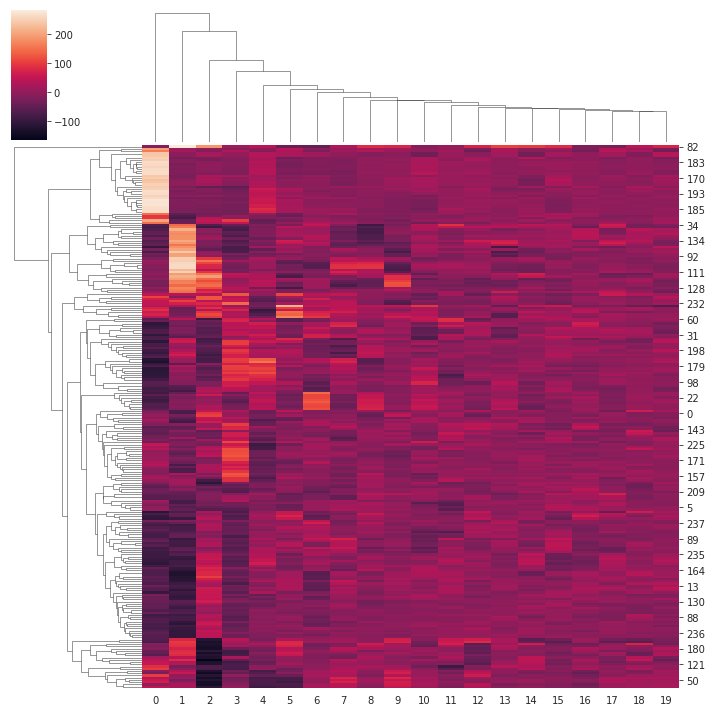

In [ ]:
c =  seaborn.clustermap(tssdata_collapsed_fw_norm_pca,metric='euclidean')

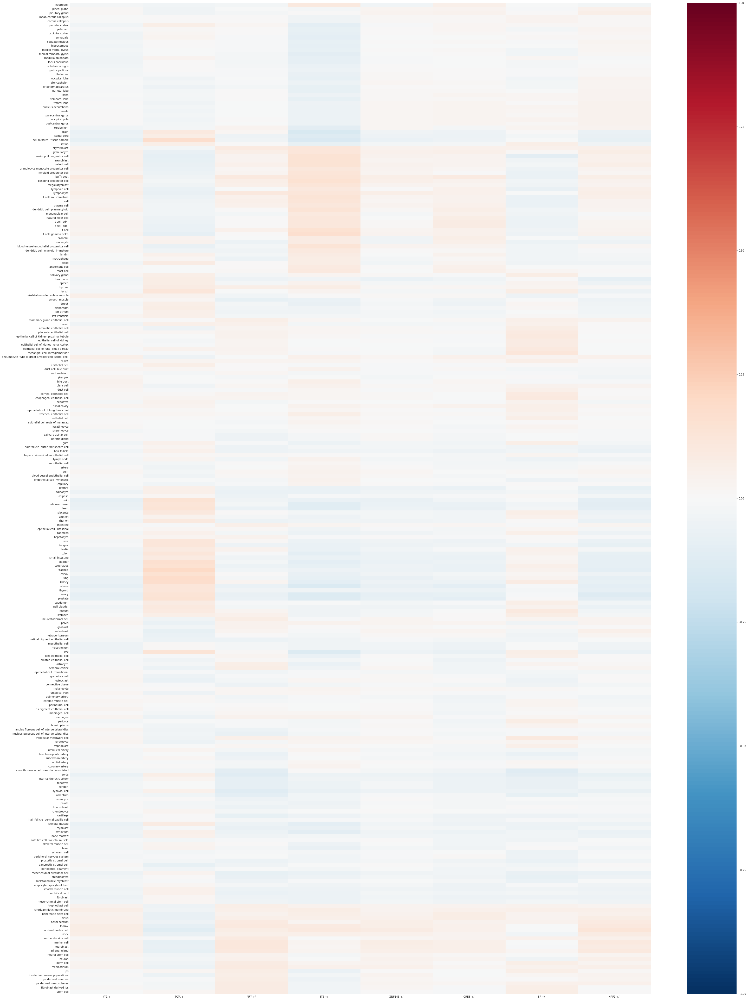

In [ ]:
plt.figure(figsize=(50,70))
seaborn.heatmap(pd.DataFrame(np.corrcoef(motifcontri_df.iloc[tssdata_collapsed_filter,:].T,
            np.log(1+tssdata_collapsed_fw_norm.T)- np.log(1+tssdata_collapsed_fw_norm.T).mean(axis=0)[None,:] )[:8,8:].T, columns=motifcontri_df.columns,
            index=fantom_tissue_filenames_short).iloc[np.array(c.dendrogram_row.reordered_ind),:],cmap='RdBu_r',center=0,vmax=1,vmin=-1)
plt.savefig('./figures/motifcontri_tissueexp.pdf')

In [ ]:
tssdata_collapsed_fw_norm_meanlog =  np.log(tssdata_collapsed_fw_norm.mean(axis=1))
tssdata_collapsed_fw_norm_displog =  2 * np.log(tssdata_collapsed_fw_norm.std(axis=1)/tssdata_collapsed_fw_norm.mean(axis=1))

plotdata = pd.DataFrame(dict(x=np.tile(tssdata_collapsed_fw_norm_meanlog,20), 
           y=np.tile(tssdata_collapsed_fw_norm_displog,20), 
                c=np.concatenate([motifcontri_weighted[:40000,0,:][tssdata_collapsed_filter,np.array(motifnames_original)==m] for m in motifnames_original]),
                alpha=np.concatenate([motifcontri_weighted[:40000,0,:][tssdata_collapsed_filter,np.array(motifnames_original)==m] for m in motifnames_original]),
                motif = np.repeat(motifnames_original, np.sum(tssdata_collapsed_filter))),
                )

plotdata = pd.concat([plotdata,pd.DataFrame(dict(x=tssdata_collapsed_fw_norm_meanlog, 
               y=tssdata_collapsed_fw_norm_displog, 
                c=motifcontri_weighted[:40000,0,inds_noinrnoss][tssdata_collapsed_filter].sum(axis=-1),
                alpha=motifcontri_weighted[:40000,0,inds_noinrnoss][tssdata_collapsed_filter].sum(axis=-1),
                motif = np.repeat('All motifs', np.sum(tssdata_collapsed_filter)))
                )])

plotdata = pd.concat([plotdata,pd.DataFrame(dict(x=tssdata_collapsed_fw_norm_meanlog, 
               y=tssdata_collapsed_fw_norm_displog, 
                c=motifcontri_weighted[:40000,0,motifnames_original.tolist().index('Long Inr +')][tssdata_collapsed_filter],
                alpha=motifcontri_weighted[:40000,0,motifnames_original.tolist().index('Long Inr +')][tssdata_collapsed_filter],
                motif = np.repeat('Long Inr +', np.sum(tssdata_collapsed_filter)))
                )])


In [ ]:
pearsonr(tssdata_collapsed_fw_norm_displog,
         motifcontri_weighted[:40000,0,motifnames_original.tolist().index('TATA +')][tssdata_collapsed_filter])



(0.21028694214350796, 0.0)

In [ ]:
pearsonr(tssdata_collapsed_fw_norm_displog,
         motifcontri_weighted[:40000,0,motifnames_original.tolist().index('YY1 +')][tssdata_collapsed_filter])



(-0.1914009262974397, 0.0)

In [ ]:
%%R 
require(scales)
theme_Publication <- function(base_size=14, base_family="helvetica") {
      library(grid)
      library(ggthemes)
      (theme_foundation(base_size=base_size, base_family=base_family)
       + theme(plot.title = element_text(face = "bold",
                                         size = rel(1.2), hjust = 0.5),
               text = element_text(),
               panel.background = element_rect(colour = NA),
               plot.background = element_rect(colour = NA),
               panel.border = element_rect(colour = NA),
               axis.title = element_text(face = "bold",size = rel(1)),
               axis.title.y = element_text(angle=90,vjust =2),
               axis.title.x = element_text(vjust = -0.2),
               axis.text = element_text(), 
               axis.line = element_line(colour="black"),
               axis.ticks = element_line(),
               panel.grid.major = element_blank(),
               panel.grid.minor = element_blank(),
               legend.key = element_rect(colour = NA),
               legend.position = "bottom",
               legend.direction = "horizontal",
               legend.key.size= unit(1, "cm"),
               legend.margin = unit(0, "cm"),
               legend.title = element_text(face="italic"),
               plot.margin=unit(c(10,5,5,5),"mm"),
               strip.background=element_rect(colour="#f0f0f0",fill="#f0f0f0"),
               strip.text = element_text(face="bold")
          ))
      
}
scale_fill_Publication <- function(...){
      discrete_scale("fill","Publication",manual_pal(values = c("#386cb0","#fdb462","#7fc97f","#ef3b2c","#662506","#a6cee3","#fb9a99","#984ea3","#ffff33")), ...)

}
scale_colour_Publication <- function(...){
      discrete_scale("colour","Publication",manual_pal(values = c("#386cb0","#fdb462","#7fc97f","#ef3b2c","#662506","#a6cee3","#fb9a99","#984ea3","#ffff33")), ...)

}

R[write to console]: Loading required package: scales



R[write to console]: Saving 12 x 12 in image



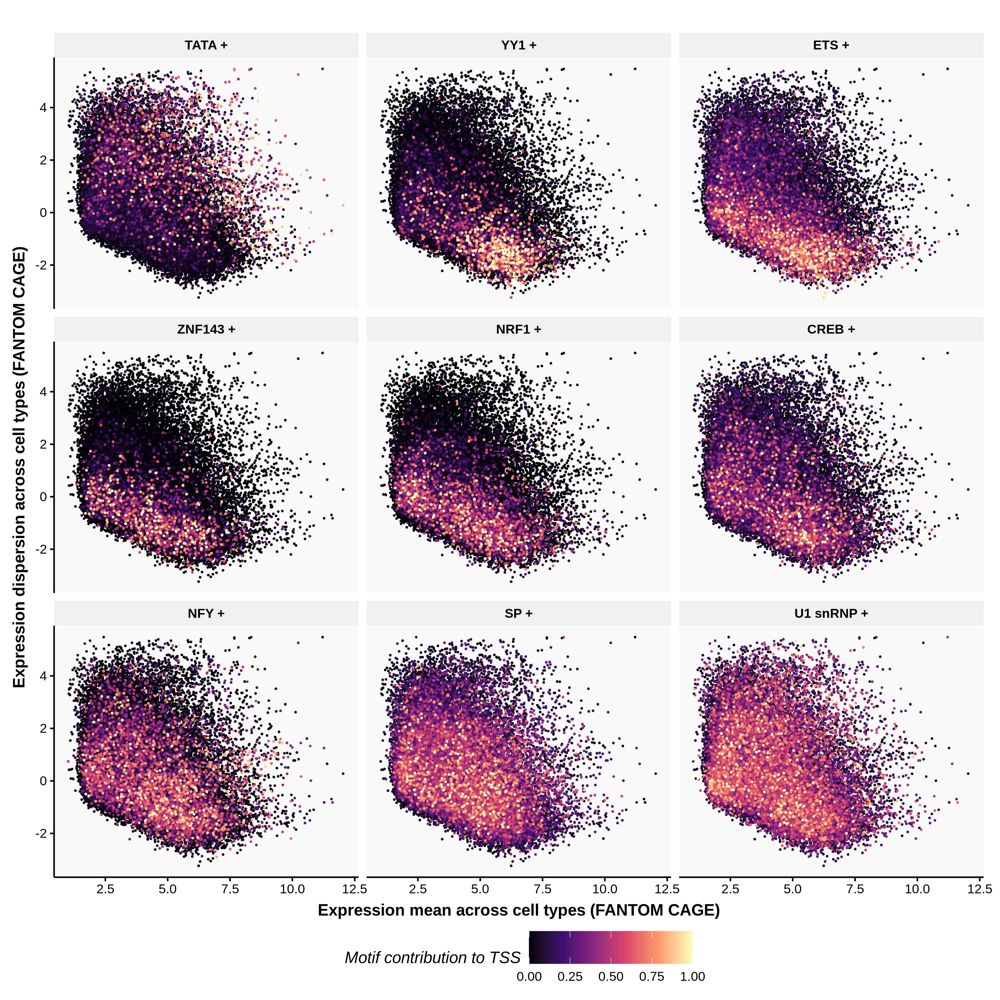

In [ ]:
%%R  -i plotdata -w 12 -h 12 --unit in --res 300
require(ggplot2)
require(data.table)
require(ggrastr)

plotdata$c[plotdata$motif == 'SP +'] = plotdata$c[plotdata$motif == 'SP +'] + plotdata$c[plotdata$motif == 'SP -']
plotdata$c[plotdata$motif == 'NFY +'] = plotdata$c[plotdata$motif == 'NFY +'] + plotdata$c[plotdata$motif == 'NFY -']
plotdata$c[plotdata$motif == 'NRF1 +'] = plotdata$c[plotdata$motif == 'NRF1 +'] + plotdata$c[plotdata$motif == 'NRF1 -']
plotdata$c[plotdata$motif == 'ETS +'] = plotdata$c[plotdata$motif == 'ETS +'] + plotdata$c[plotdata$motif == 'ETS -']
plotdata$c[plotdata$motif == 'ZNF143 +'] = plotdata$c[plotdata$motif == 'ZNF143 +'] + plotdata$c[plotdata$motif == 'ZNF143 -']
plotdata$c[plotdata$motif == 'CREB +'] = plotdata$c[plotdata$motif == 'CREB +'] + plotdata$c[plotdata$motif == 'CREB -']

plotdata=data.table(plotdata)
plotdata[,c:=c/quantile(c,0.998),by=motif]
plotdata[,alpha:=alpha/max(alpha),by=motif]
plotdata$c[plotdata$c>1]=1

plotdata$motif= factor(plotdata$motif, levels=c( 'TATA +',
 'YY1 +',
 'ETS +',
 'ZNF143 +',
 'NRF1 +',
 'CREB +',
 'NFY +',
 'SP +',
 "U1 snRNP +",
"All motifs",
"Long Inr +"

 ))
head(plotdata$motif)
#plotdata[motif != 'All motifs',] = plotdata[motif != 'All motifs',][order(motif,c),]
plotdata = plotdata[order(motif,c),]

p = ggplot(plotdata[(motif %in% c('TATA +','YY1 +','NFY +','NRF1 +','ETS +','SP +','ZNF143 +','CREB +', 'U1 snRNP +')),])+theme_Publication()+
    xlab('Expression mean across cell types (FANTOM CAGE)')+ylab('Expression dispersion across cell types (FANTOM CAGE)')+
    xlim(1,12.1)+ labs(color='Motif contribution to TSS', size='') +
    scale_size_continuous(range=c(0,0.31))+facet_wrap(~motif)+scale_color_viridis_c(option="magma")+guides(size="none", alpha="none")+ 
    theme( panel.background = element_rect(fill = "gray98")) + rasterise(geom_point(aes(x=x,y=y,color=pmax(c,0), size=alpha)), dpi = 300)
ggsave('./figures/motif_dispersion.pdf', device = cairo_pdf)
p

R[write to console]: Saving 5 x 5 in image



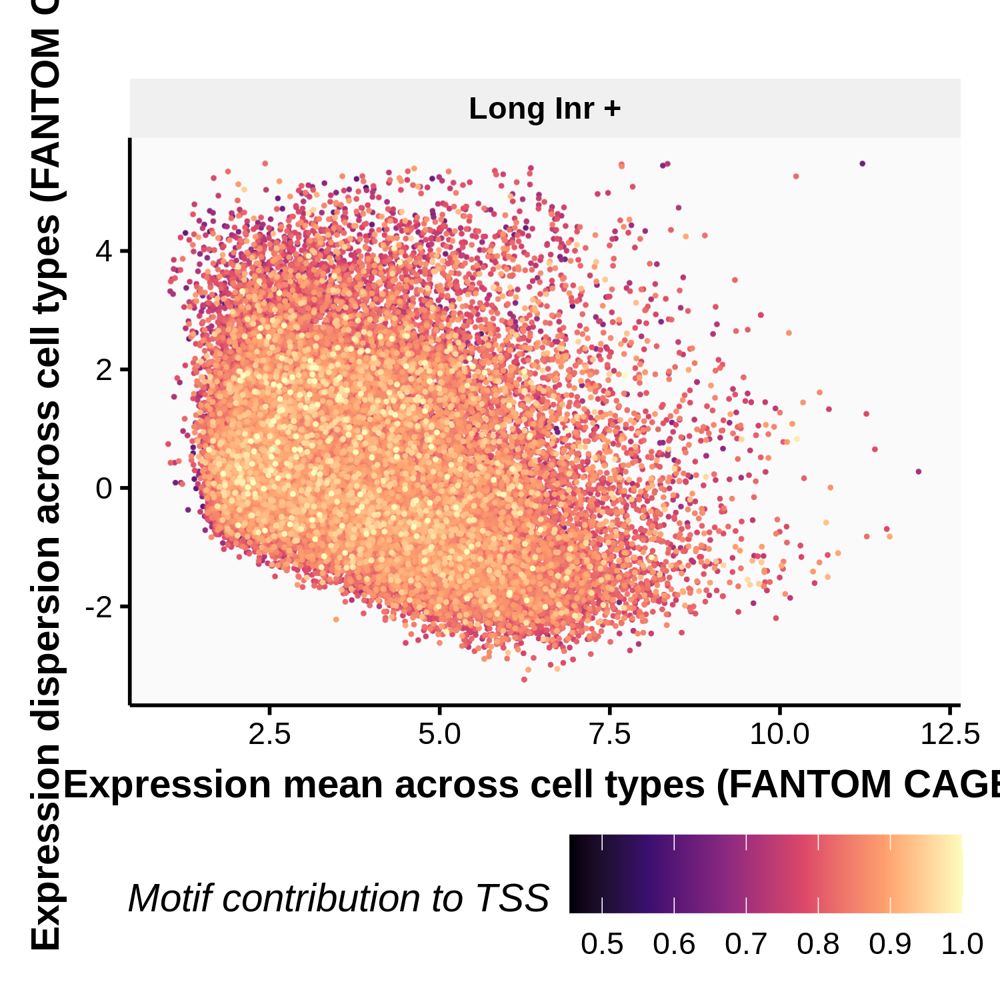

In [ ]:
%%R  -w 5 -h 5 --unit in --res 300
p = ggplot(plotdata[(motif %in% c('Long Inr +')),])+theme_Publication()+
    xlab('Expression mean across cell types (FANTOM CAGE)')+ylab('Expression dispersion across cell types (FANTOM CAGE)')+
    xlim(1,12.1)+ labs(color='Motif contribution to TSS', size='') +
    scale_size_continuous(range=c(0,0.1))+facet_wrap(~motif)+scale_color_viridis_c(option="magma")+guides(size="none", alpha="none")+ 
    theme( panel.background = element_rect(fill = "gray98")) + rasterise(geom_point(aes(x=x,y=y,color=pmax(c,0), size=alpha)), dpi = 300)
ggsave('./figures/motif_dispersion.longinr.pdf', device = cairo_pdf)
p

R[write to console]: Saving 5 x 5 in image



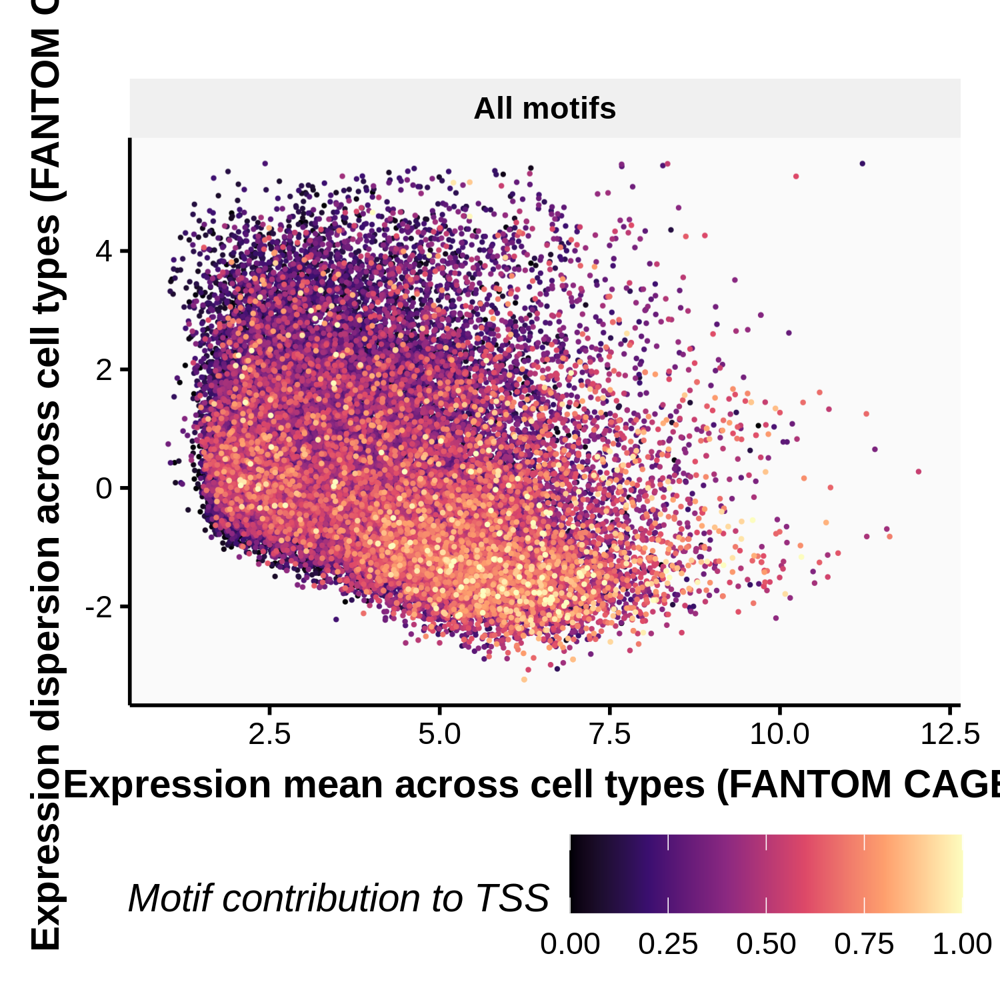

In [ ]:
%%R  -w 5 -h 5 --unit in --res 300
p = ggplot(plotdata[(motif %in% c('All motifs')),])+theme_Publication()+
    xlab('Expression mean across cell types (FANTOM CAGE)')+ylab('Expression dispersion across cell types (FANTOM CAGE)')+
    xlim(1,12.1)+ labs(color='Motif contribution to TSS', size='') +
    scale_size_continuous(range=c(0,0.1))+facet_wrap(~motif)+scale_color_viridis_c(option="magma")+guides(size="none", alpha="none")+ 
    theme( panel.background = element_rect(fill = "gray98")) + rasterise(geom_point(aes(x=x,y=y,color=pmax(c,0), size=alpha)), dpi = 300)
ggsave('./figures/motif_dispersion.allmotifs.pdf', device = cairo_pdf)
p

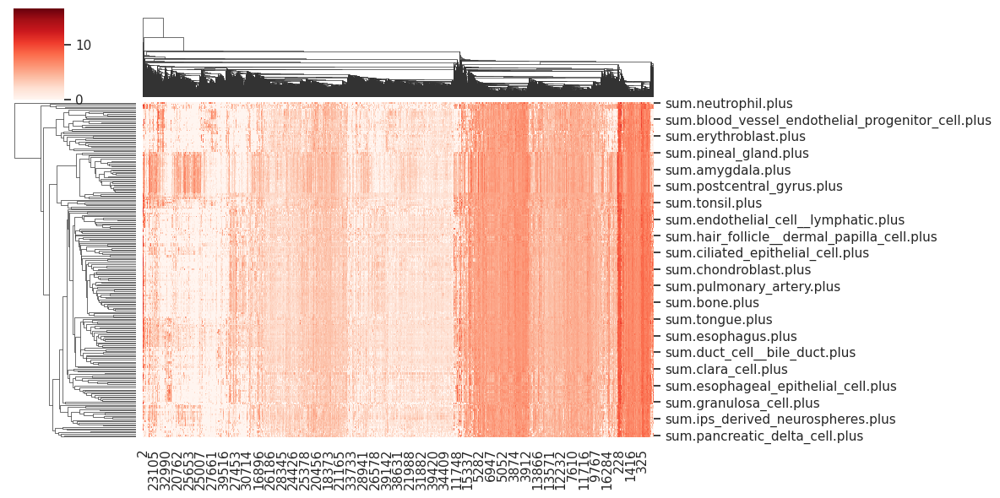

In [ ]:
c = seaborn.clustermap(pd.DataFrame(np.log(1+tssdata_collapsed_fw_norm[:np.sum(tssdata_collapsed_filter)]),
                                    columns=fantom_tissue_filenames).T,
                       cmap='Reds',figsize=(12,6))
roworder = c.dendrogram_row.reordered_ind
colorder = c.dendrogram_col.reordered_ind


In [ ]:
thresh

0.44736166298389435

YY1 +
0.050017514887654504


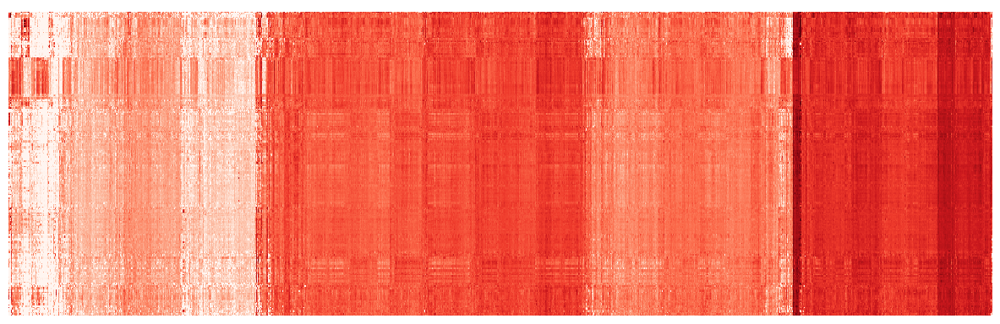

TATA +
0.050017514887654504


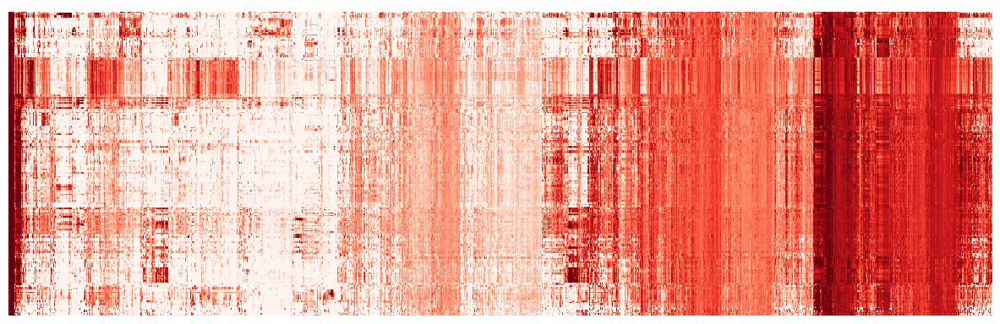

NFY +/-
0.050017514887654504


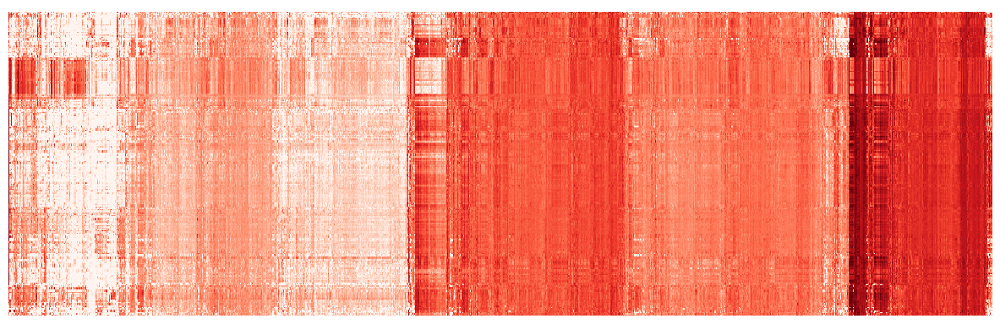

ETS +/-
0.050017514887654504


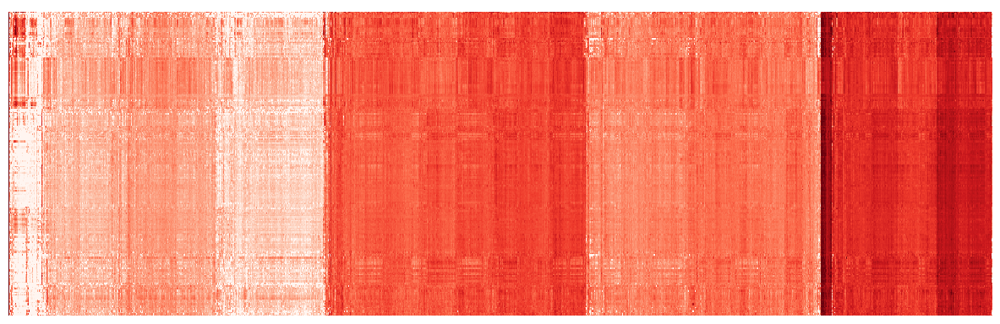

ZNF143 +/-
0.050017514887654504


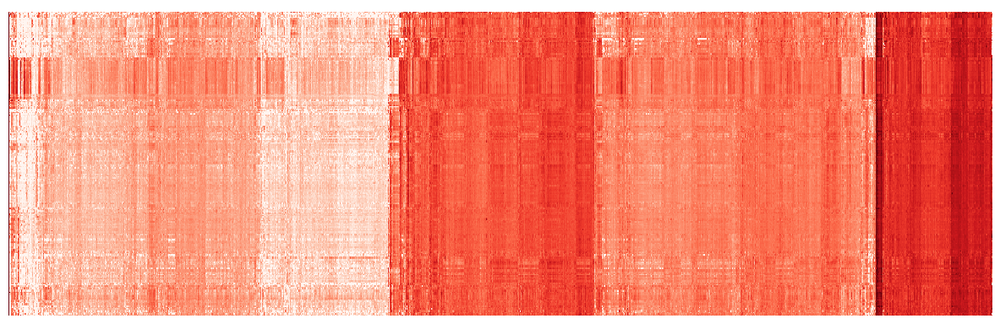

CREB +/-
0.050017514887654504


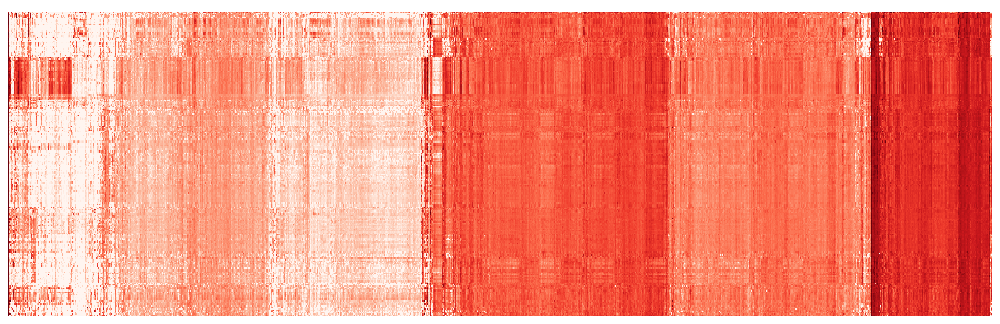

SP +/-
0.050017514887654504


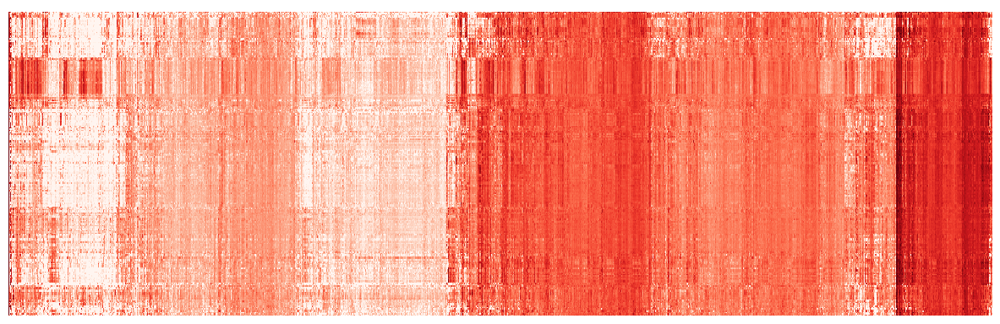

NRF1 +/-
0.050017514887654504


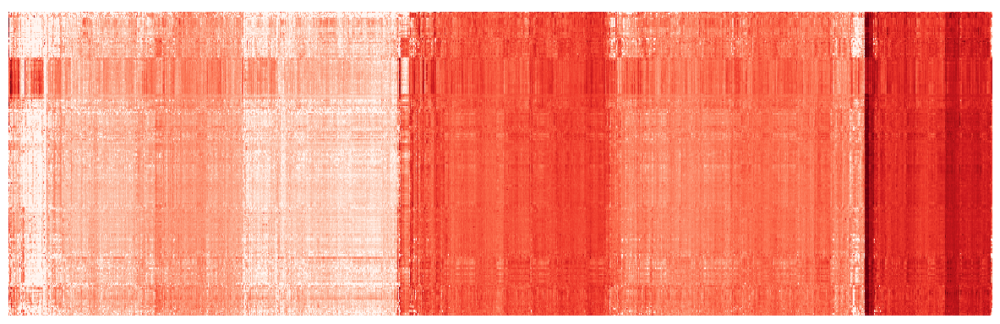

In [ ]:
seaborn.set(rc={"figure.dpi":100, 'savefig.dpi':100})
fantom_tissue_filenames_short = [( s.replace('sum.','').replace('.plus','').replace('_',' ')) for s in fantom_tissue_filenames]


motifcontri_argmax = motifcontri_df.values[:40000].argmax(axis=1)

for i in range(motifcontri_df.shape[1]):
    print(motifcontri_df.columns[i])
    plotdata = pd.DataFrame(np.log(1+tssdata_collapsed_fw_norm[:np.sum(tssdata_collapsed_filter)])[colorder],columns=fantom_tissue_filenames_short).T.iloc[roworder,:]
    
    thresh = np.percentile(motifcontri_df.values[:40000][tssdata_collapsed_filter][:,i], 95)
    filteri = motifcontri_df.values[:40000][tssdata_collapsed_filter][colorder][:,i] > thresh
    print(np.mean(filteri))
    c = seaborn.clustermap(plotdata.iloc[:,filteri], row_cluster=False, col_cluster=False,  dendrogram_ratio=(0,0.01),
                       cmap='Reds', vmax=10,figsize=(12,4),yticklabels=False,xticklabels=False)
    c.cax.set_visible(False)
    plt.show()

In [ ]:
lines = []
path = './data/Insertion_screen/'

for i in range(40000):
    filename = 'Ins_screen_exp_TSS_'+str(i)+'.npy'
    file = np.load(path+filename)
    line = file[:,0,0] #prediction from +-20bps
    lines.append(line)
    
insertion = np.array(lines)


In [ ]:
n_targets = insertion.shape[1]

In [ ]:
selectivity_index = dict(zip(motifcontri_df.columns, np.corrcoef(motifcontri_df.T,((insertion < ( np.sort(insertion, axis=1)[:,-3:].mean(axis=1)/3)[:,None]).sum(axis=1).T+1))[:8,8:]))
selectivity_index


{'YY1 +': array([-0.28877794]),
 'TATA +': array([0.09333608]),
 'NFY +/-': array([-0.06737141]),
 'ETS +/-': array([-0.23619256]),
 'ZNF143 +/-': array([-0.11735139]),
 'CREB +/-': array([-0.13567765]),
 'SP +/-': array([-0.04673943]),
 'NRF1 +/-': array([-0.16432698])}

In [ ]:
mean_express_index = dict(zip(motifcontri_df.columns, np.corrcoef(motifcontri_df.T, insertion.mean(axis=1))[:8,8:]))
max_express_index = dict(zip(motifcontri_df.columns, np.corrcoef(motifcontri_df.T, insertion.max(axis=1))[:8,8:]))

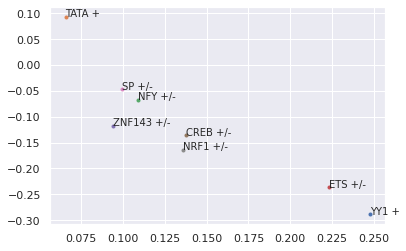

In [ ]:
from matplotlib import pyplot as plt
%matplotlib inline
for k in mean_express_index:
    plt.plot(mean_express_index[k], selectivity_index[k], '.')
    plt.text(mean_express_index[k], selectivity_index[k], k)

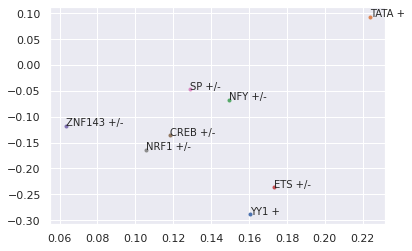

In [ ]:
from matplotlib import pyplot as plt
%matplotlib inline
for k in max_express_index:
    plt.plot(max_express_index[k], selectivity_index[k], '.')
    plt.text(max_express_index[k], selectivity_index[k], k)

In [ ]:
nabovethreshold =  (insertion > (np.sort(insertion, axis=1)[:,-3:].mean(axis=1)/3)[:,None]).sum(axis=1).T

R[write to console]: Loading required package: reshape

R[write to console]: 
Attaching package: ‘reshape’


R[write to console]: The following object is masked from ‘package:data.table’:

    melt


R[write to console]: The following objects are masked from ‘package:S4Vectors’:

    expand, rename


R[write to console]: Saving 6 x 6 in image



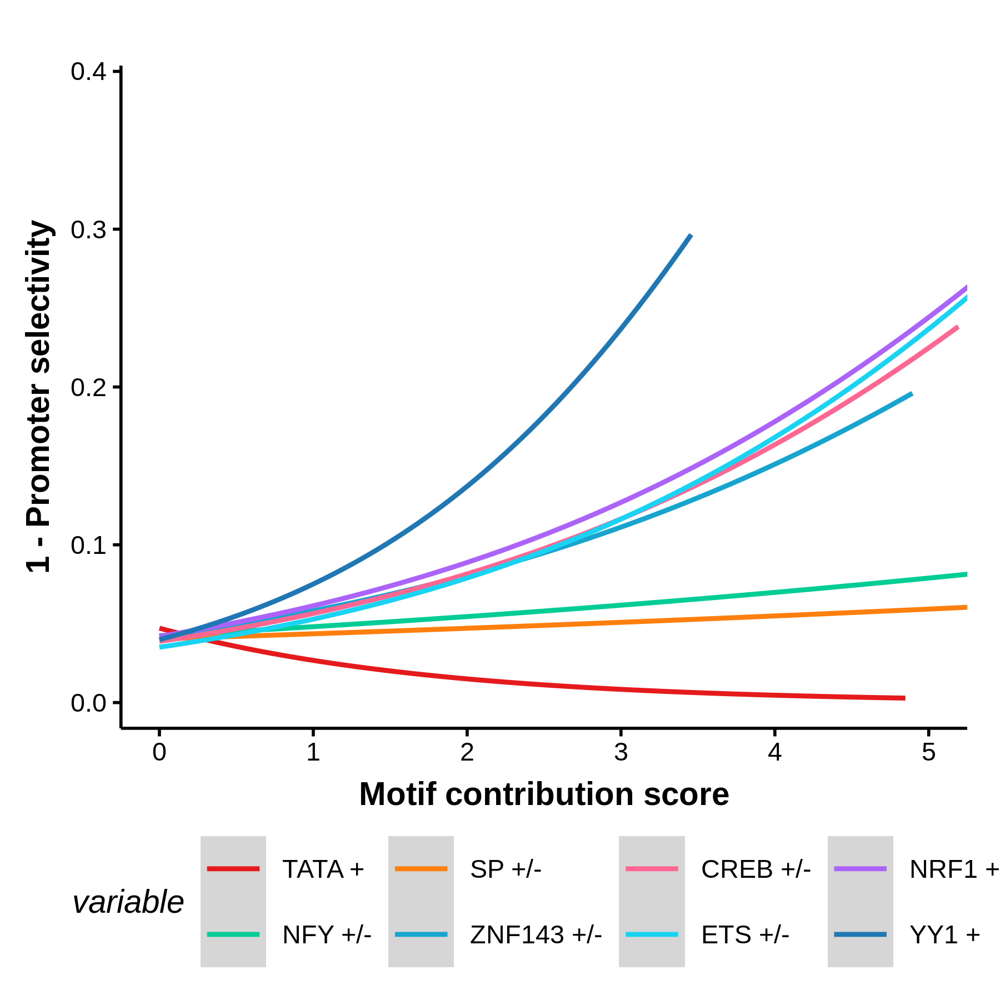

In [ ]:
%%R -i motifcontri_df,nabovethreshold,n_targets  -w 6 -h 6 --unit in --res 300
require(ggplot2)
require(reshape)

motifcontri_df$nabovethreshold = nabovethreshold
motifcontri_df_long = melt(motifcontri_df, id.vars = "nabovethreshold")
logit_count <- trans_new("logitcount",
                        transform =  function(x){log(x) - log(1-x)},
                         inverse= function(x){1/(1+exp(-x))}
)
                        
motifcontri_df_long$variable= factor(motifcontri_df_long$variable, levels=c('TATA +','NFY +/-','SP +/-','ZNF143 +/-','CREB +/-','ETS +/-','NRF1 +/-','YY1 +'))


p = ggplot(motifcontri_df_long[motifcontri_df_long$value>0,])+
    geom_smooth(aes(x=value,y=nabovethreshold/n_targets, succ=nabovethreshold,fail=n_targets-nabovethreshold, color=variable),
    method="glm",
    method.args=list(family="binomial"),
    formula = cbind(succ, fail) ~ x,
                se=T
  )+ coord_cartesian(xlim=c(0,5) )+theme_Publication()+
    xlab('Motif contribution score') + ylab('1 - Promoter selectivity')+
    scale_color_manual(values=c('#E41A1C','#00CC96','#FF7F0E','#17a4cf','#FF6692','#19d3f3','#AB63FA','#1F77B4'))


ggsave('./figures/selecitivty_motifcontribution.glm.pdf', device=cairo_pdf)
p

In [ ]:
# %%R -i motifcontri_df,nabovethreshold,n_targets  -w 12 -h 12 --unit in --res 300

# motifcontri_df$nabovethreshold = nabovethreshold
# motifcontri_df_long = melt(motifcontri_df, id.vars = "nabovethreshold")
# require(ggplot2)
# motifcontri_df_long$variable= factor(motifcontri_df_long$variable, levels=c('TATA +','NFY +/-','SP +/-','ZNF143 +/-','CREB +/-','ETS +/-','NRF1 +/-','YY1 +'))

# p = ggplot(motifcontri_df_long[motifcontri_df_long$value>0,])+geom_point(aes(x=value,y=-log((nabovethreshold+1)/(n_targets-selectivity+1))),size=I(0.05),alpha=I(0.5))+
#     geom_smooth(aes(x=value,y=-log((nabovethreshold+1)/(n_targets-nabovethreshold+1)), color=variable),method=lm)+
#     facet_wrap(~variable)+
#     theme_Publication()+xlab('Motif contribution score') + ylab('logit(Selectivity index)')+
#     scale_color_manual(values=c('#E41A1C','#00CC96','#FF7F0E','#17a4cf','#FF6692','#19d3f3','#AB63FA','#1F77B4'))


# ggsave('./figures/selectivity_motifcontribution.facet_wrap.pdf', device=cairo_pdf)
# p

R[write to console]: Saving 6 x 6 in image

R[write to console]: `geom_smooth()` using formula 'y ~ x'

R[write to console]: `geom_smooth()` using formula 'y ~ x'



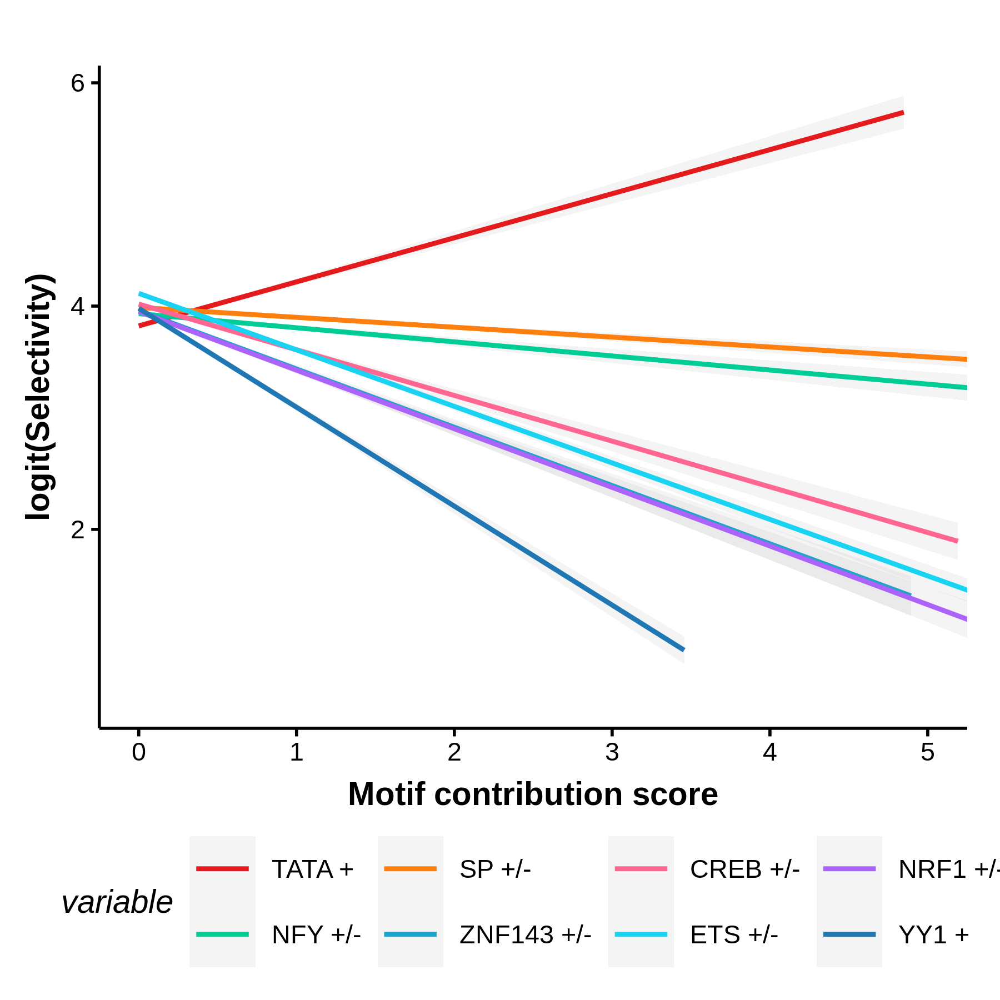

In [ ]:
%%R -i motifcontri_df,nabovethreshold,n_targets  -w 6 -h 6 --unit in --res 300

motifcontri_df$nabovethreshold = nabovethreshold
motifcontri_df_long = melt(motifcontri_df, id.vars = "nabovethreshold")
require(ggplot2)
motifcontri_df_long$variable= factor(motifcontri_df_long$variable, levels=c('TATA +','NFY +/-','SP +/-','ZNF143 +/-','CREB +/-','ETS +/-','NRF1 +/-','YY1 +'))
p=ggplot(motifcontri_df_long[motifcontri_df_long$value>0,])+
    geom_smooth(aes(x=value,y=-log((nabovethreshold+1)/(n_targets-nabovethreshold+1)), color=variable),method=lm,alpha=I(0.1))+
    theme_Publication()+xlab('Motif contribution score') + ylab('logit(Selectivity)')+coord_cartesian(xlim=c(0,5) )+
    scale_color_manual(values=c('#E41A1C','#00CC96','#FF7F0E','#17a4cf','#FF6692','#19d3f3','#AB63FA','#1F77B4'))


ggsave('./figures/selecitivty_motifcontribution.pdf', device=cairo_pdf)
p

In [ ]:
xs = []
ys = []
ts = []
plotdata = pd.DataFrame(np.array([insertion[np.argsort(motifcontri_df[c].values)[-1000:],:].mean(0) for c in motifcontri_df.columns.values]),
                        index = motifcontri_df.columns)
for m in plotdata.index.values:
    xs.append(np.arange(insertion.shape[1],0,-1))
    ys.append( plotdata.T[m].values[targetinds] /  np.median(plotdata.T[m].values[targetinds]))
    ts.append(np.repeat(m, insertion.shape[1]))
plotdata = pd.DataFrame(dict(x=np.concatenate(xs), y=np.concatenate(ys), t=np.concatenate(ts)))

R[write to console]: Saving 6 x 6 in image

R[write to console]: `geom_smooth()` using method = 'gam' and formula 'y ~ s(x, bs = "cs")'

R[write to console]: `geom_smooth()` using method = 'gam' and formula 'y ~ s(x, bs = "cs")'



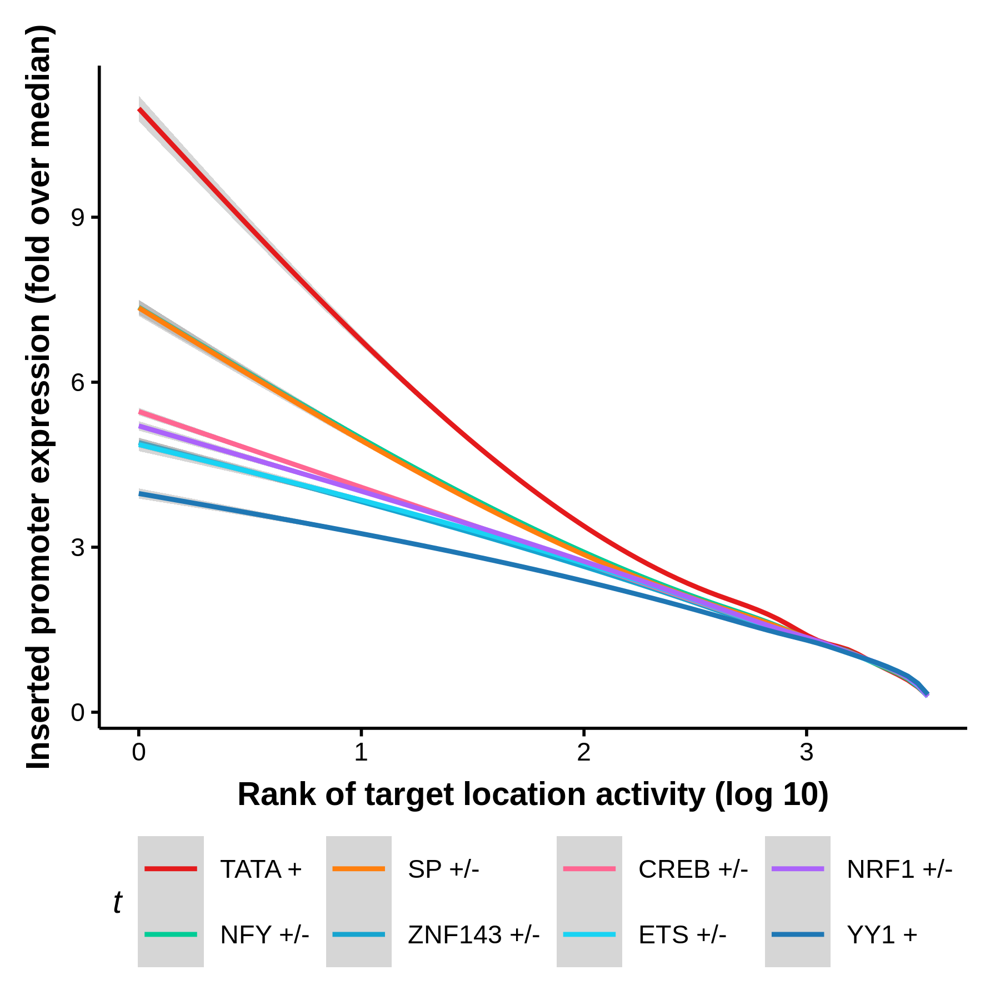

In [ ]:
%%R -i plotdata -w 6 -h 6 --unit in --res 300
require(ggplot2)
plotdata$t= factor(plotdata$t, levels=c('TATA +','NFY +/-','SP +/-','ZNF143 +/-','CREB +/-','ETS +/-','NRF1 +/-','YY1 +'))

p = ggplot(plotdata)+#geom_point(aes(x=sqrt(x),y=y, color=t), size=I(1))+
    geom_smooth(aes(x=log10(x),y=y, color=t))+theme_Publication()+
    scale_color_manual(values=c('#E41A1C','#00CC96','#FF7F0E','#17a4cf','#FF6692','#19d3f3','#AB63FA','#1F77B4'))+
    xlab('Rank of insertion location activity (log 10)') + ylab('Inserted promoter expression (fold over median)')
ggsave('./figures/selecitivty_expvstarget.pdf', device=cairo_pdf)
p
#+coord_trans(x=scales::exp_trans(10))

In [ ]:
plotdata = pd.DataFrame(np.array([insertion[np.argsort(motifcontri_df[c].values)[-1000:],:].mean(0) for c in motifcontri_df.columns.values]),
                        index = motifcontri_df.columns)

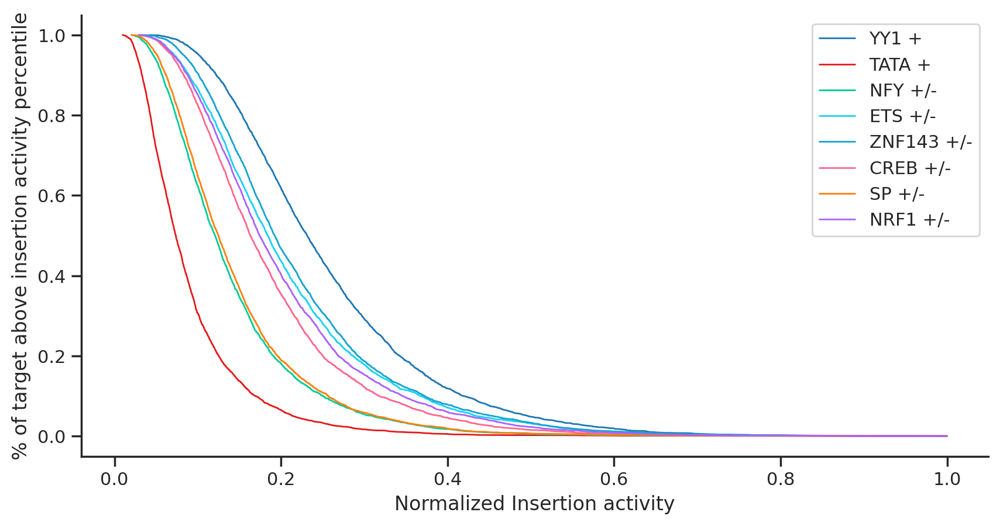

In [ ]:
import seaborn
from matplotlib import pyplot as plt
seaborn.set_style('white')
_, ax=plt.subplots(dpi=200, figsize=(10,5))
for m in plotdata.index.values:
    ax.plot(np.sort(plotdata.T[m].values[targetinds] /  plotdata.T[m].values[targetinds].max()), (np.arange(insertion.shape[1],0,-1)/insertion.shape[1]),
            color=colordict[m.replace('/-','')],label=m,linewidth=1)
ax.legend()
plt.xlabel('Normalized Insertion activity')
plt.ylabel('% of target above insertion activity percentile')
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')
seaborn.despine()
plt.savefig('./figures/selecitivty_schemaplot.pdf')

In [ ]:
#predict selectivity by motif contribution

In [ ]:
from sklearn.linear_model import RidgeCV
lr = RidgeCV(alphas=np.logspace(-1,2,10)).fit(X=motifcontri_df.values, y= np.log((1+nabovethreshold)/(3500-nabovethreshold+1)))


In [ ]:
dict(zip(motifcontri_df.columns, lr.coef_))

{'YY1 +': 0.7395212008566532,
 'TATA +': -0.2689681136046329,
 'NFY +/-': 0.1819171990547801,
 'ETS +/-': 0.46088288557601764,
 'ZNF143 +/-': 0.44557787312727576,
 'CREB +/-': 0.3210798839265214,
 'SP +/-': 0.13666679956118521,
 'NRF1 +/-': 0.497640626195647}

In [ ]:
tssdata_collapsed_fw_norm_meanlog =  np.log(tssdata_collapsed_fw_norm.mean(axis=1))
tssdata_collapsed_fw_norm_displog =  2 * np.log(tssdata_collapsed_fw_norm.std(axis=1)/tssdata_collapsed_fw_norm.mean(axis=1))

plotdata = pd.DataFrame(dict(x=np.tile(tssdata_collapsed_fw_norm_meanlog,2), 
           y=np.tile(tssdata_collapsed_fw_norm_displog,2), 
                c=np.concatenate([-np.log((1+nabovethreshold)/(n_targets-nabovethreshold+1))[tssdata_collapsed_filter],
                                  -lr.predict(motifcontri_df.values)[tssdata_collapsed_filter]]),
                alpha=np.concatenate([-np.log((1+nabovethreshold)/(n_targets-nabovethreshold+1))[tssdata_collapsed_filter],
                                  -lr.predict(motifcontri_df.values)[tssdata_collapsed_filter]]),
                motif = np.repeat(['Selectivity index', 'Motif selectivity index'], 
                                  np.sum(tssdata_collapsed_filter))),
                )




R[write to console]: Saving 5 x 5 in image



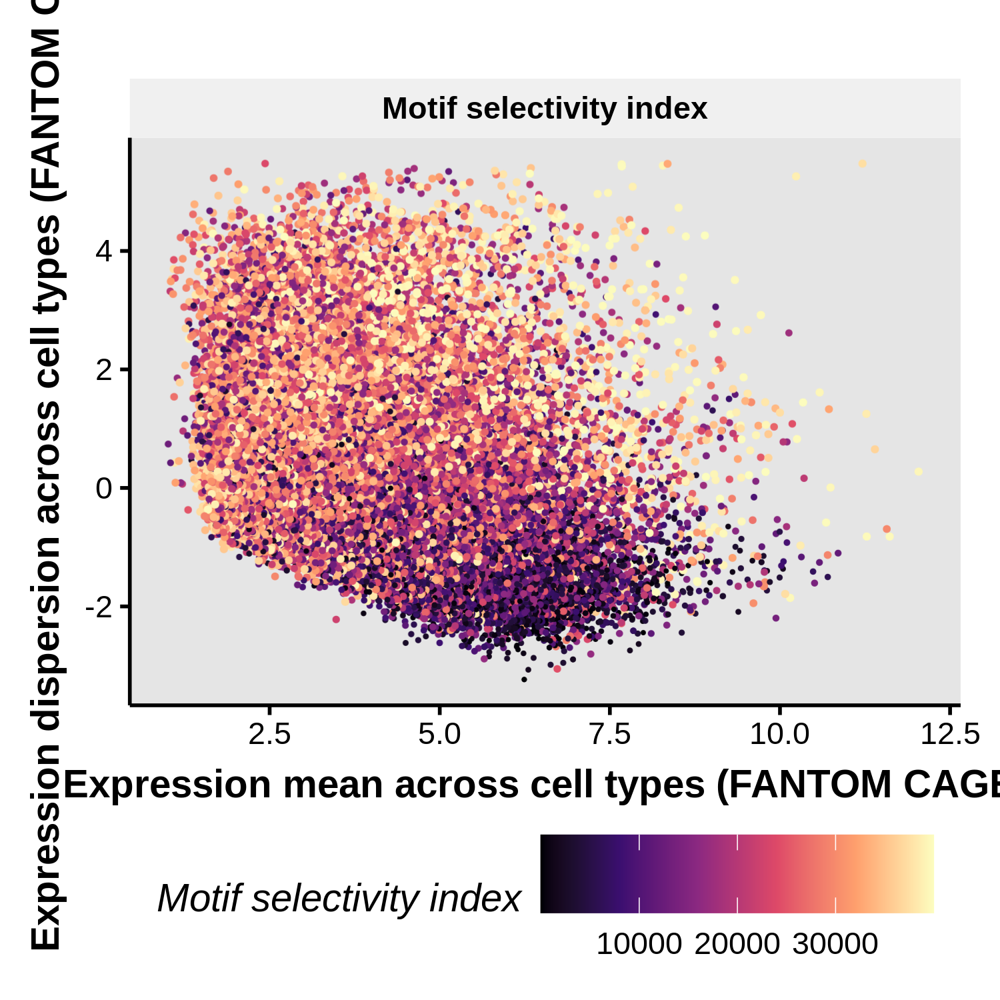

In [ ]:
%%R  -i plotdata -w 5 -h 5 --unit in --res 300
require(ggplot2)
require(data.table)
require(ggrastr)

plotdata=data.table(plotdata)

head(plotdata$motif)
plotdata = plotdata[motif=='Motif selectivity index']
p = ggplot(plotdata)+theme_Publication()+
    xlab('Expression mean across cell types (FANTOM CAGE)')+ylab('Expression dispersion across cell types (FANTOM CAGE)')+
    xlim(1,12.1)+ labs(color='Motif selectivity index', size='') +
    scale_size_continuous(range=c(0,0.5))+facet_wrap(~motif)+scale_color_viridis_c(option="magma")+guides(size="none", alpha="none")+ 
    theme( panel.background = element_rect(fill = "gray90")) + rasterise(geom_point(aes(x=x,y=y,color=rank(c), size=rank(alpha))), dpi = 300)
ggsave('./figures/motif_dispersion.selectivity_index.pdf', device = cairo_pdf)
p

R[write to console]: Saving 5 x 5 in image



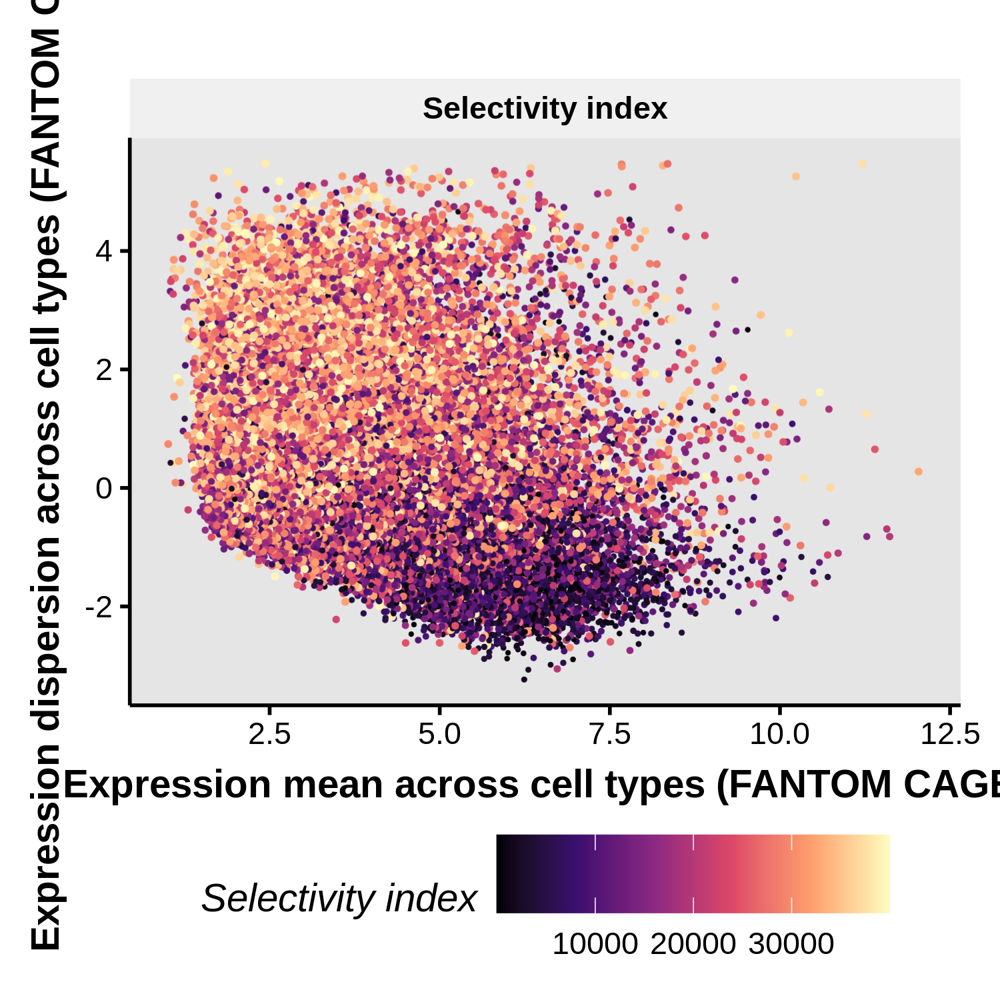

In [ ]:
%%R  -i plotdata -w 5 -h 5 --unit in --res 300
require(ggplot2)
require(data.table)
require(ggrastr)

plotdata=data.table(plotdata)
plotdata = plotdata[motif=='Selectivity index']
p = ggplot(plotdata)+theme_Publication()+
    xlab('Expression mean across cell types (FANTOM CAGE)')+ylab('Expression dispersion across cell types (FANTOM CAGE)')+
    xlim(1,12.1)+ labs(color='Selectivity index', size='') +
    scale_size_continuous(range=c(0,0.5))+facet_wrap(~motif)+scale_color_viridis_c(option="magma")+guides(size="none", alpha="none")+ 
    theme( panel.background = element_rect(fill = "gray90")) + rasterise(geom_point(aes(x=x,y=y,color=rank(c), size=rank(alpha))), dpi = 300)
ggsave('./figures/motif_dispersion.motif_selectivity_index.pdf', device = cairo_pdf)
p

In [ ]:
spearmanr(-np.log((1+nabovethreshold[tssdata_collapsed_filter])/(3500-nabovethreshold[tssdata_collapsed_filter]+1)),
         tssdata_collapsed_fw_norm_displog)

SpearmanrResult(correlation=0.45356398895227634, pvalue=0.0)

In [ ]:
spearmanr(-lr.predict(motifcontri_df.values)[tssdata_collapsed_filter],
         tssdata_collapsed_fw_norm_displog)

SpearmanrResult(correlation=0.4077477901162187, pvalue=0.0)

In [ ]:
spearmanr(-lr.predict(motifcontri_df.values)[tssdata_collapsed_filter]-np.log((1+nabovethreshold[tssdata_collapsed_filter])/(3500-selectivity[tssdata_collapsed_filter]+1)),
         tssdata_collapsed_fw_norm_displog)

SpearmanrResult(correlation=0.5053856535676634, pvalue=0.0)

In [ ]:
data = pd.concat([tsses['geneName'][:40000],  \
    pd.Series(-np.log((1+nabovethreshold)/(3500-nabovethreshold+1)), name='Selectivity (Puffin-D)'), \
 pd.Series(-lr.predict(motifcontri_df.values), name='Motif Selectivity')], axis=1)
data['Dispersion index'] = np.nan
data['Dispersion index'].values[tssdata_collapsed_filter] = tssdata_collapsed_fw_norm_displog
data['Mean expression'] = np.nan
data['Mean expression'].values[tssdata_collapsed_filter] = tssdata_collapsed_fw_norm_meanlog
data.to_csv('./data/selectivity.tsv',sep='\t')

In [ ]:
import tabix 
#epilogo
tb = tabix.open('./resources/hg38.15.all.KL.gz')

targets_pos = range(22964801, 29964801, 2000)

epidict = { "11": [
    "Flanking Bivalent TSS/Enh",
    "#e9967a"
  ],
  "10": [
    "Bivalent/Poised TSS",
    "#cd5c5c"
  ],
  "13": [
    "Repressed PolyComb",
    "#808080"
  ],
  "12": [
    "Bivalent Enhancer",
    "#bdb76b"
  ],
  "15": [
    "Quiescent/Low",
    "#ffffff"
  ],
  "14": [
    "Weak Repressed PolyComb",
    "#c0c0c0"
  ],
  "1": [
    "Active TSS",
    "#ff0000"
  ],
  "3": [
    "Transcr at gene 5' and 3'",
    "#32cd32"
  ],
  "2": [
    "Flanking Active TSS",
    "#ff4500"
  ],
  "5": [
    "Weak transcription",
    "#006400"
  ],
  "4": [
    "Strong transcription",
    "#008000"
  ],
  "7": [
    "Enhancers",
    "#ffff00"
  ],
  "6": [
    "Genic enhancers",
    "#c2e105"
  ],
  "9": [
    "Heterochromatin",
    "#8a91d0"
  ],
  "8": [
    "ZNF genes & repeats",
    "#66cdaa"]}

epilogos = []
for i in range(len(targets_pos)):
    try:
        epilogos.append(np.array(list(tb.query('chr8', targets_pos[i], targets_pos[i]+1)))[:,3:].astype(float).mean(axis=0))
    except:
        epilogos.append(np.zeros(15))
epilogos = np.vstack(epilogos)    



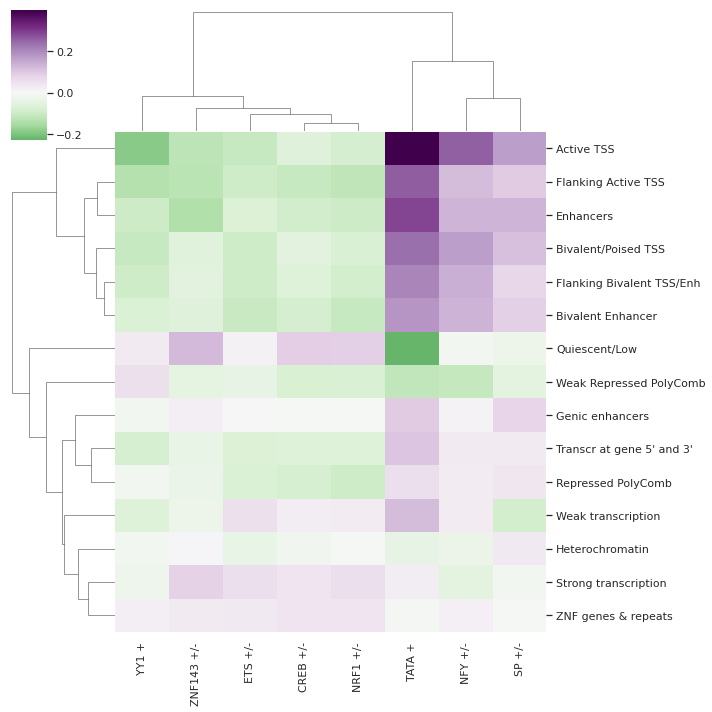

In [ ]:
seaborn.clustermap(pd.DataFrame(np.corrcoef(epilogos.T, np.corrcoef(motifcontri_df.values.T, insertion.T)[:8,8:])[:15,15:], 
                             index=[epidict[str(i+1)][0] for i in range(15)],columns=motifcontri_df.columns),
                  cmap='PRGn_r',center=0)



In [ ]:
cormat = np.corrcoef(motifcontri_df.values.T, insertion.T)[:8,8:]

In [ ]:
plotdata = []
for i in range(15):
    plotdata.append(cormat[:,epilogos.argmax(axis=-1)==i].mean(axis=-1))


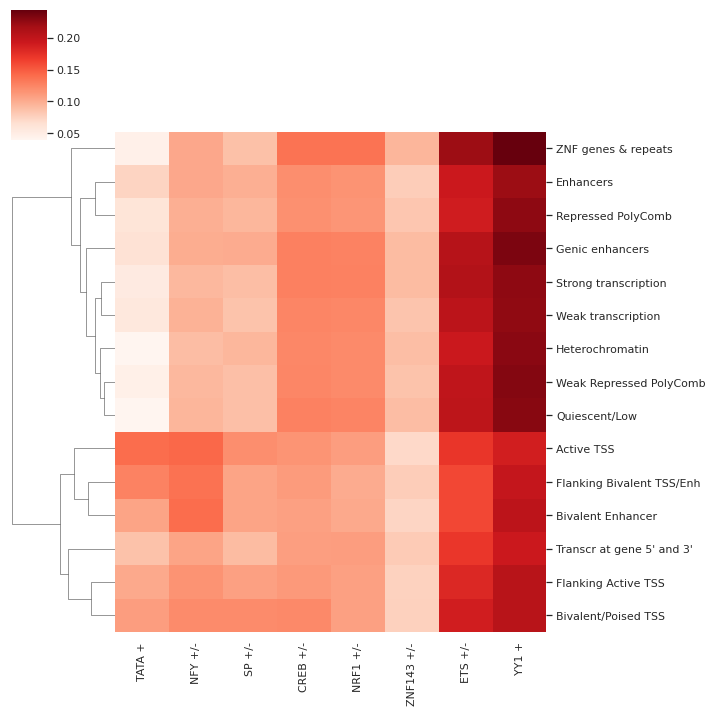

In [ ]:
seaborn.clustermap(pd.DataFrame(np.array(plotdata),columns=motifcontri_df.columns,
                   index=[epidict[str(i+1)][0] for i in range(15)]).loc[:,
                    ['TATA +','NFY +/-','SP +/-', 'CREB +/-', 'NRF1 +/-', 'ZNF143 +/-', 'ETS +/-','YY1 +']],cmap='Reds',col_cluster=False)
plt.savefig('./figures/insertion_motif_epilogos.pdf', backend='cairo')


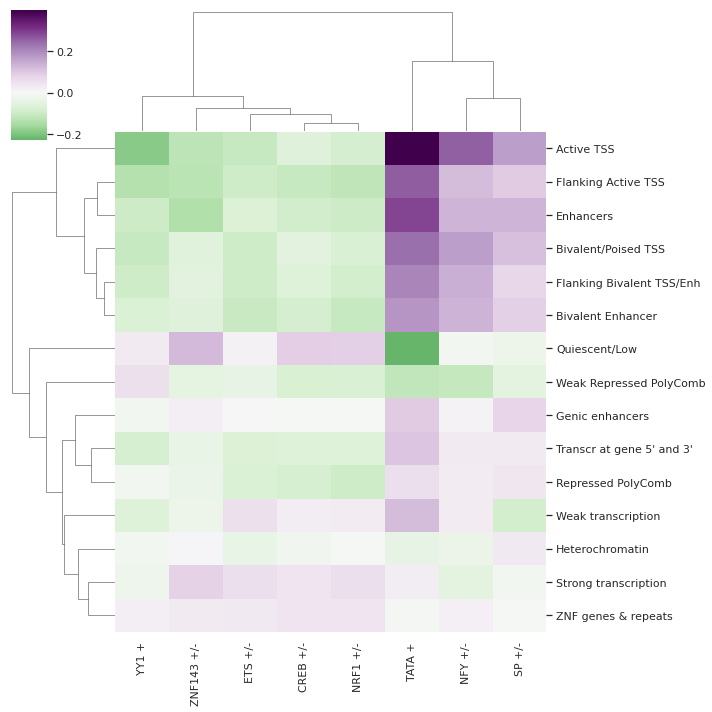

In [ ]:
seaborn.clustermap(pd.DataFrame(np.corrcoef(epilogos.T, np.corrcoef(motifcontri_df.values.T, insertion.T)[:8,8:])[:15,15:], 
                             index=[epidict[str(i+1)][0] for i in range(15)],columns=motifcontri_df.columns),
                  cmap='PRGn_r',center=0)
plt.savefig('./figures/insertion_motif_epilogos.cor.pdf', backend='cairo')

